# Exploratory Data Analysis (EDA) for Cybersecurity Intrusion Detection

This is done using the [KDD Cup 99 Dataset](http://kdd.ics.uci.edu/databases/kddcup99/kddcup99.html).

## Contents

- Installation
- Data loading and dataset overview
- Plotting feature distributions
 - Categorical variables
 - Continuous variables
- Plotting feature correlation matrices
  - Overall feature correlation matrices
  - Label-wise feature correlation matrices
- Plotting feature importance by fitting trees
  - Overall feature importance
  - Label-wise feature importance
- Anomaly detection by fitting normal traffic
  - Fit normal traffic
  - Check values for all traffic
  - Plotting the detected anomalies
- Improvement ideas

## Installation

- First, go in the data folder, and run the .sh script for fetching the data there.
- `pip install -r requirements.txt`
- `jupyter-notebook`
- Then you can run the notebook.

## Data loading and dataset overview

You can proceed with running the notebook to load the data:

In [1]:
import os

import pandas as pd
import numpy as np 

In [2]:
DATA_FOLDER = "./data"
FEATURE_NAMES_FILENAME = os.path.join(DATA_FOLDER, "kddcup.names")
TRAINING_DATA_FILENAME = os.path.join(DATA_FOLDER, "kddcup.data")
TRAINING_ATTK_FILENAME = os.path.join(DATA_FOLDER, "training_attack_types")

with open(FEATURE_NAMES_FILENAME, 'r') as kddcup_names:
    label_names = kddcup_names.readline().strip().split(",")
    

    _remainder = kddcup_names.readlines()

    feature_names = [l.split(": ")[0] for l in _remainder] + ["target"]
    feature_types = [l.split(": ")[1].split(".")[0] for l in _remainder] + ["continuous"]

with open(TRAINING_ATTK_FILENAME, 'r') as training_attack_names_f:
    training_attack_names = training_attack_names_f.read().strip().split("\n")

training_attack_names

['back dos',
 'buffer_overflow u2r',
 'ftp_write r2l',
 'guess_passwd r2l',
 'imap r2l',
 'ipsweep probe',
 'land dos',
 'loadmodule u2r',
 'multihop r2l',
 'neptune dos',
 'nmap probe',
 'perl u2r',
 'phf r2l',
 'pod dos',
 'portsweep probe',
 'rootkit u2r',
 'satan probe',
 'smurf dos',
 'spy r2l',
 'teardrop dos',
 'warezclient r2l',
 'warezmaster r2l']

In [3]:
df = pd.read_csv(TRAINING_DATA_FILENAME, names=feature_names)
df.drop_duplicates(subset=None, keep='first', inplace=True)

df.shape

(1074992, 42)

In [4]:
# These are "categorical" variables to convert to one-hot:
symbolic_features = [
    f for (t, f) in zip(feature_types, feature_names) 
    if (t == 'symbolic' and not (
        df.dtypes[f] == int and df.nunique()[f] <= 2
    ) and t != 'count')
]
symbolic_features

['protocol_type', 'service', 'flag']

In [5]:
continuous_features = [
    f for (t, f) in zip(feature_types, feature_names) 
    if t == "continuous"
]
continuous_features

['duration',
 'src_bytes',
 'dst_bytes',
 'wrong_fragment',
 'urgent',
 'hot',
 'num_failed_logins',
 'num_compromised',
 'root_shell',
 'su_attempted',
 'num_root',
 'num_file_creations',
 'num_shells',
 'num_access_files',
 'num_outbound_cmds',
 'count',
 'srv_count',
 'serror_rate',
 'srv_serror_rate',
 'rerror_rate',
 'srv_rerror_rate',
 'same_srv_rate',
 'diff_srv_rate',
 'srv_diff_host_rate',
 'dst_host_count',
 'dst_host_srv_count',
 'dst_host_same_srv_rate',
 'dst_host_diff_srv_rate',
 'dst_host_same_src_port_rate',
 'dst_host_srv_diff_host_rate',
 'dst_host_serror_rate',
 'dst_host_srv_serror_rate',
 'dst_host_rerror_rate',
 'dst_host_srv_rerror_rate',
 'target']

In [6]:
df.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,target
0,0,tcp,http,SF,215,45076,0,0,0,0,...,0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,normal.
1,0,tcp,http,SF,162,4528,0,0,0,0,...,1,1.0,0.0,1.00,0.0,0.0,0.0,0.0,0.0,normal.
2,0,tcp,http,SF,236,1228,0,0,0,0,...,2,1.0,0.0,0.50,0.0,0.0,0.0,0.0,0.0,normal.
3,0,tcp,http,SF,233,2032,0,0,0,0,...,3,1.0,0.0,0.33,0.0,0.0,0.0,0.0,0.0,normal.
4,0,tcp,http,SF,239,486,0,0,0,0,...,4,1.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,normal.


In [7]:
df.target.value_counts()

normal.             812814
neptune.            242149
satan.                5019
ipsweep.              3723
portsweep.            3564
smurf.                3007
nmap.                 1554
back.                  968
teardrop.              918
warezclient.           893
pod.                   206
guess_passwd.           53
buffer_overflow.        30
warezmaster.            20
land.                   19
imap.                   12
rootkit.                10
loadmodule.              9
ftp_write.               8
multihop.                7
phf.                     4
perl.                    3
spy.                     2
Name: target, dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1074992 entries, 0 to 4898430
Data columns (total 42 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   duration                     1074992 non-null  int64  
 1   protocol_type                1074992 non-null  object 
 2   service                      1074992 non-null  object 
 3   flag                         1074992 non-null  object 
 4   src_bytes                    1074992 non-null  int64  
 5   dst_bytes                    1074992 non-null  int64  
 6   land                         1074992 non-null  int64  
 7   wrong_fragment               1074992 non-null  int64  
 8   urgent                       1074992 non-null  int64  
 9   hot                          1074992 non-null  int64  
 10  num_failed_logins            1074992 non-null  int64  
 11  logged_in                    1074992 non-null  int64  
 12  num_compromised              1074992 non-n

In [9]:
df.nunique()

duration                        9883
protocol_type                      3
service                           70
flag                              11
src_bytes                       7195
dst_bytes                      21493
land                               2
wrong_fragment                     3
urgent                             6
hot                               30
num_failed_logins                  6
logged_in                          2
num_compromised                   98
root_shell                         2
su_attempted                       3
num_root                          93
num_file_creations                42
num_shells                         3
num_access_files                  10
num_outbound_cmds                  1
is_host_login                      2
is_guest_login                     2
count                            512
srv_count                        512
serror_rate                       96
srv_serror_rate                   87
rerror_rate                       89
s

In [10]:
df.drop('num_outbound_cmds', axis=1, inplace=True)
feature_names.remove('num_outbound_cmds')

In [11]:
# get splitted DFs per label:

intact_df_per_label = dict([i for i in df.copy().groupby(df['target'])])
with_normal_df_per_label = intact_df_per_label.copy()

df_normal = with_normal_df_per_label["normal."].copy()
df_without_normal = df[df.target != "normal."]
del with_normal_df_per_label["normal."]

# Adding the normal data next to every df:
for label, label_df in with_normal_df_per_label.items():
    label_df = pd.concat([label_df, df_normal])
    with_normal_df_per_label[label] = label_df

with_normal_df_per_label.keys()

dict_keys(['back.', 'buffer_overflow.', 'ftp_write.', 'guess_passwd.', 'imap.', 'ipsweep.', 'land.', 'loadmodule.', 'multihop.', 'neptune.', 'nmap.', 'perl.', 'phf.', 'pod.', 'portsweep.', 'rootkit.', 'satan.', 'smurf.', 'spy.', 'teardrop.', 'warezclient.', 'warezmaster.'])

## Plotting feature distributions

In [12]:
import plotly.graph_objects as go
import plotly.express as px

### Categorical variables

In [13]:
df_categorical_cols = df.select_dtypes(include='object').columns

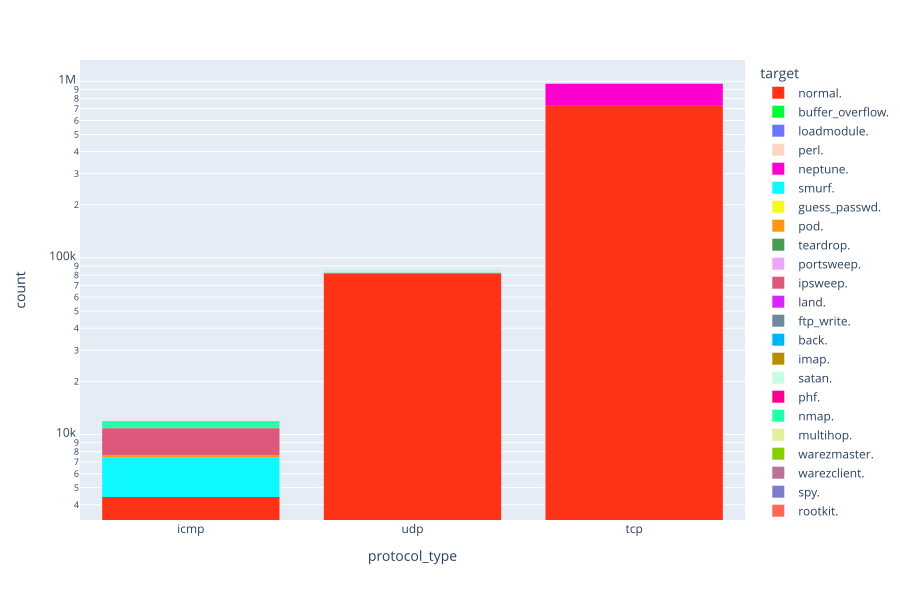

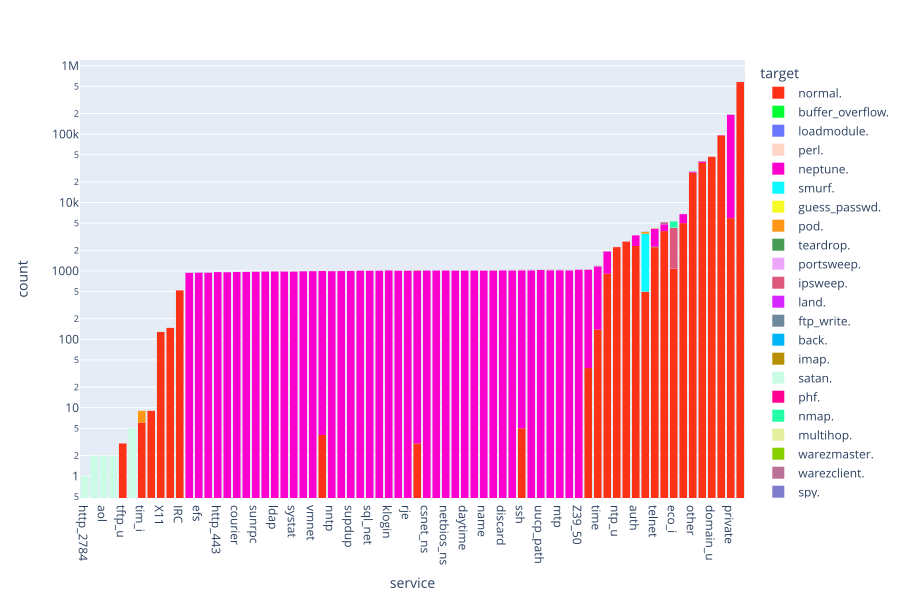

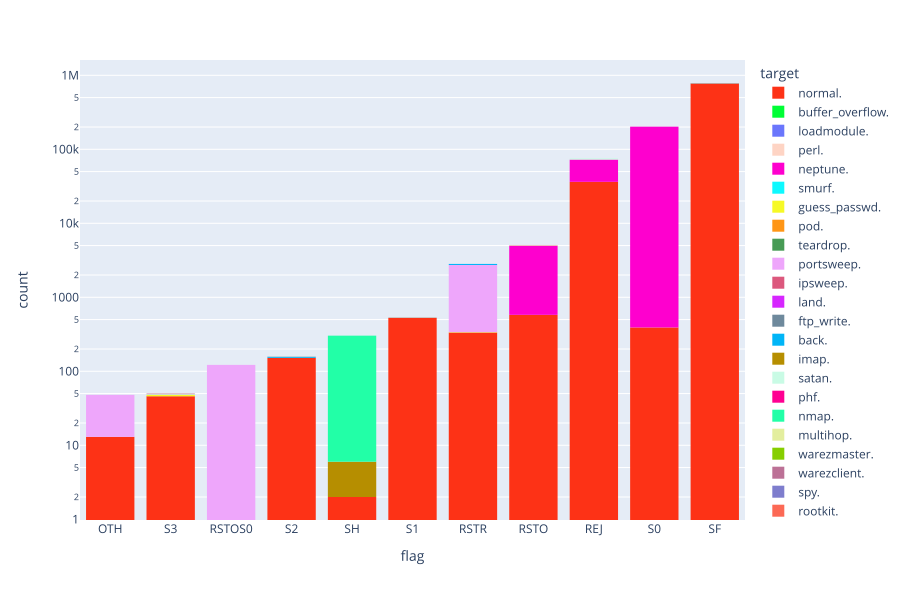

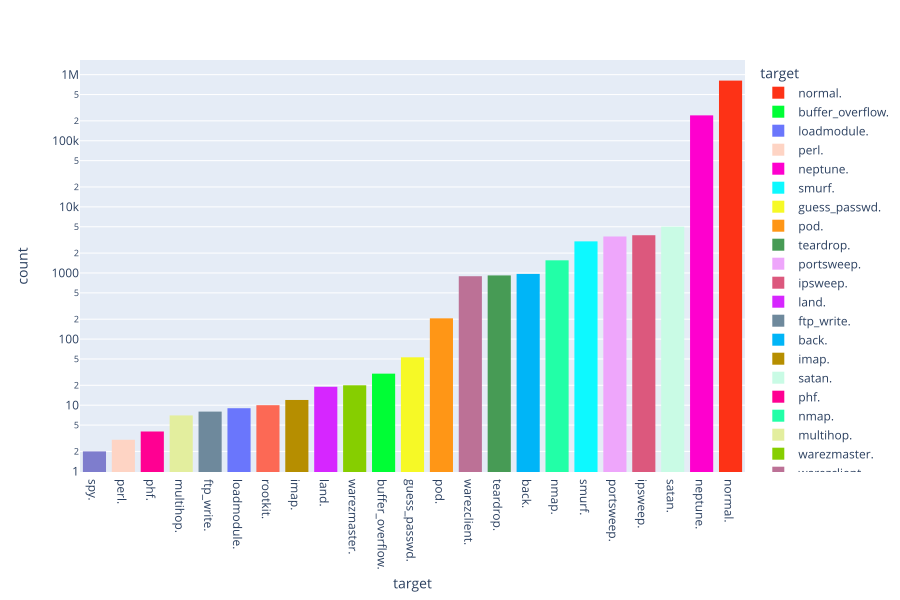

In [14]:
for feature in df_categorical_cols:
    fig = px.histogram(df, x=feature, log_y=True, color="target", color_discrete_sequence=px.colors.qualitative.Light24)
    fig.update_layout(xaxis={'categoryorder':'total ascending'})
    fig.show(renderer="svg", width=900, height=600)

### Continuous variables

In [15]:
df_continuous_cols = df.select_dtypes(exclude='object').columns

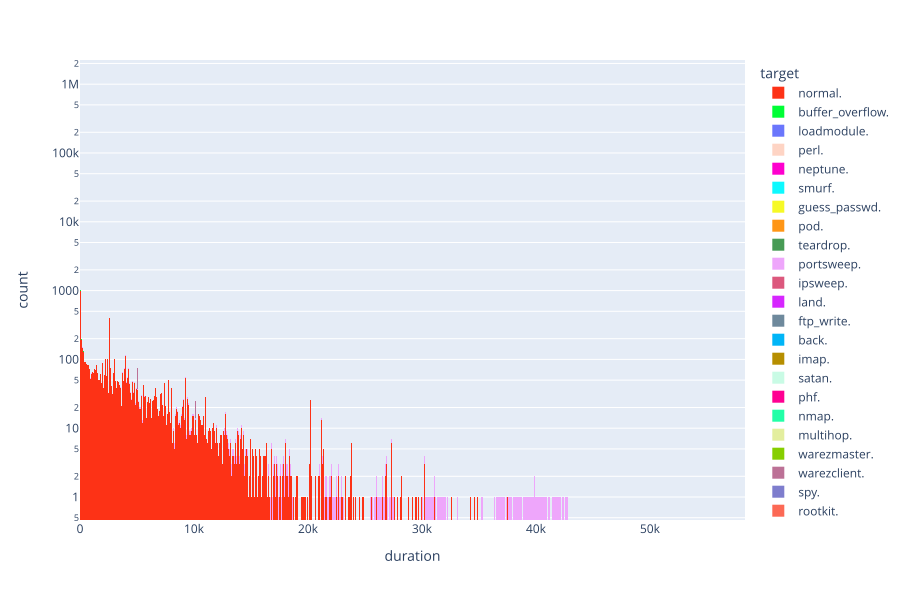

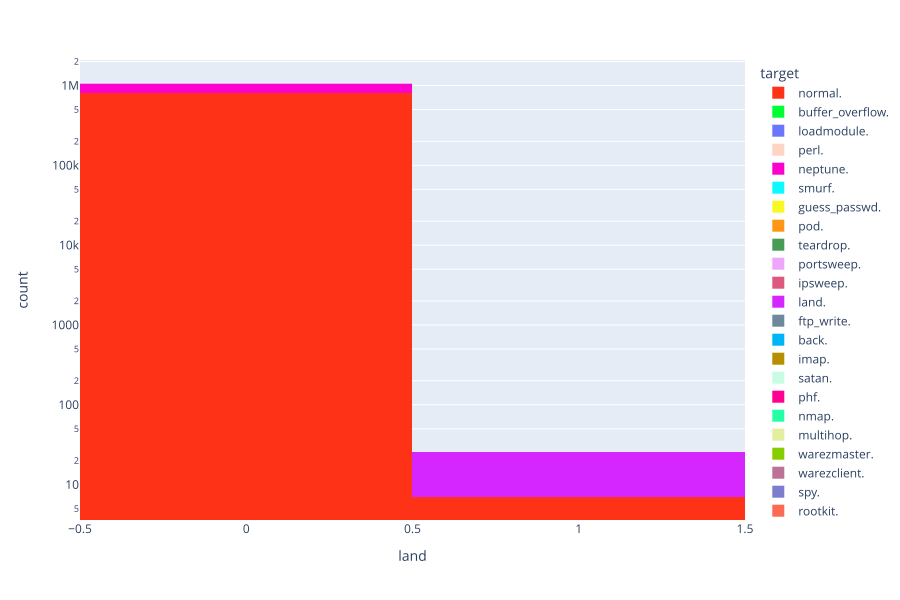

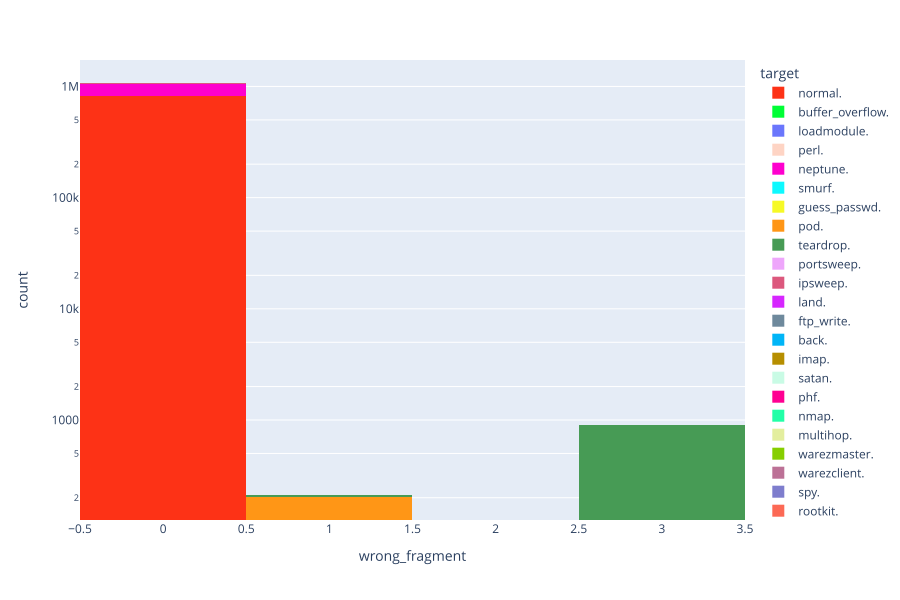

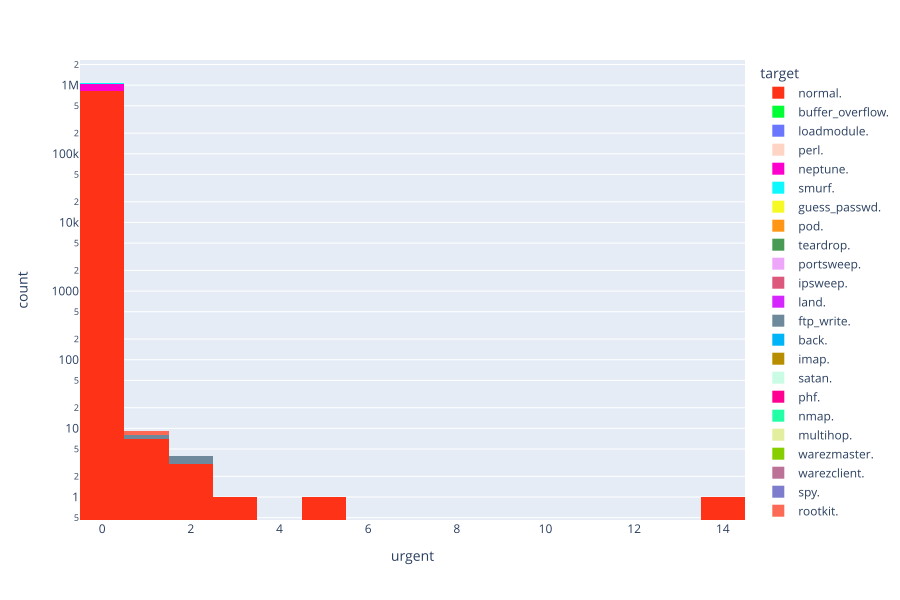

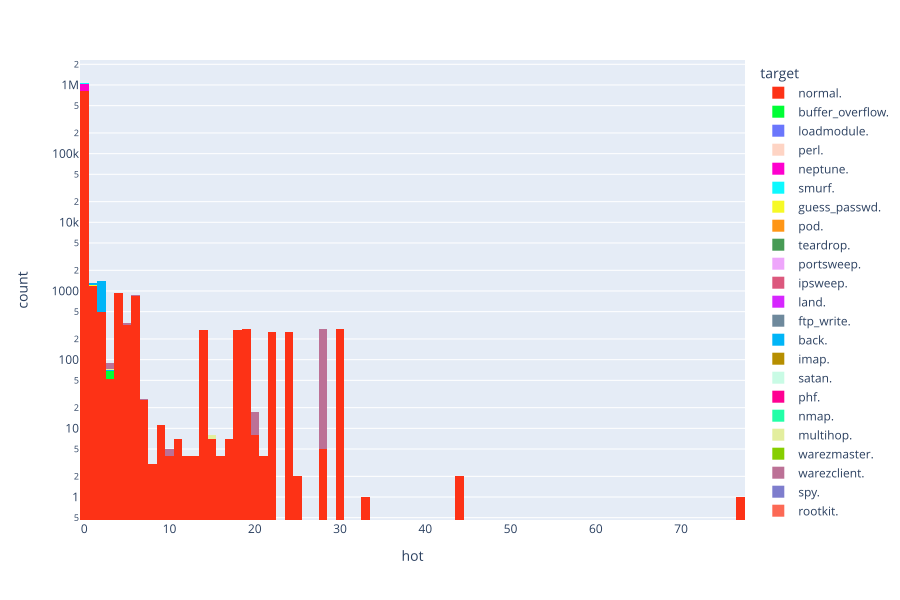

...

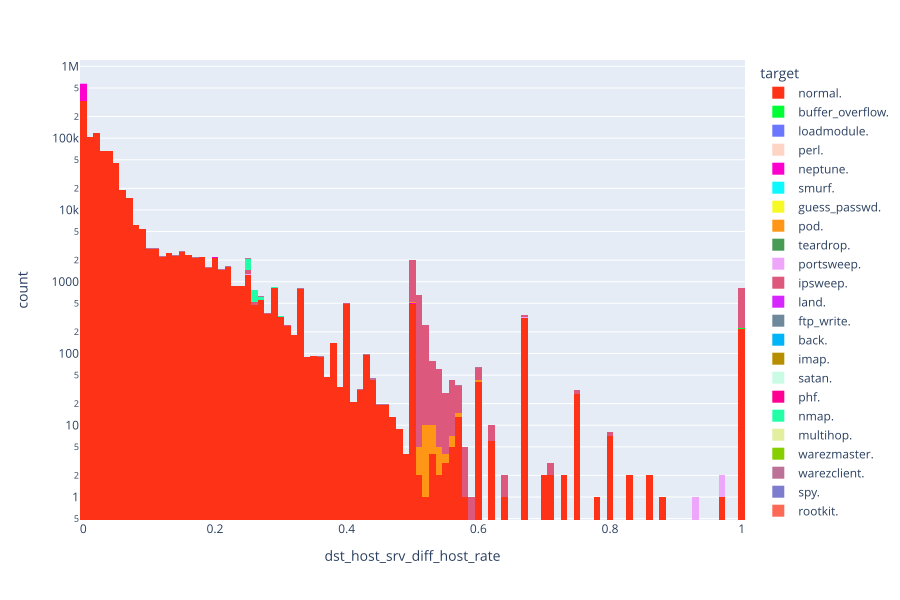

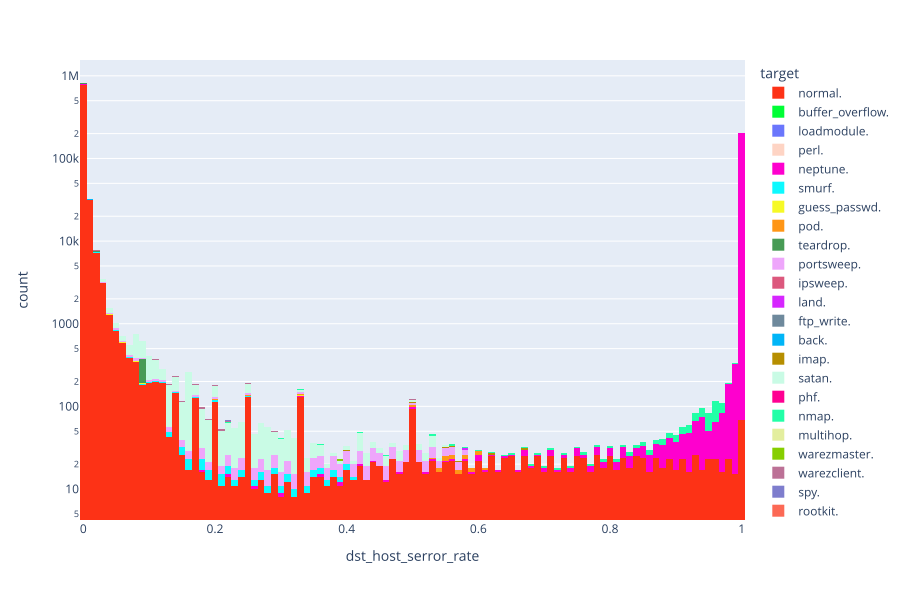

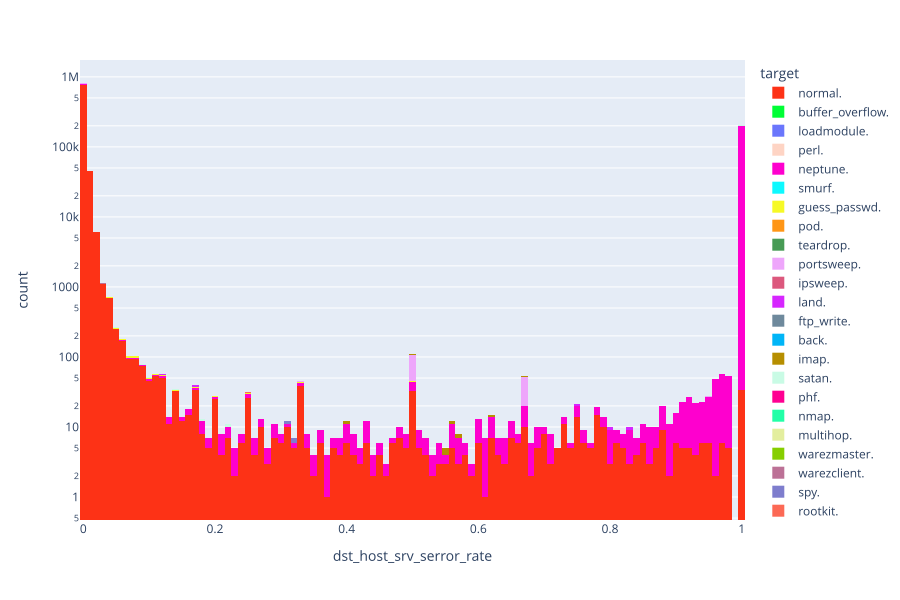

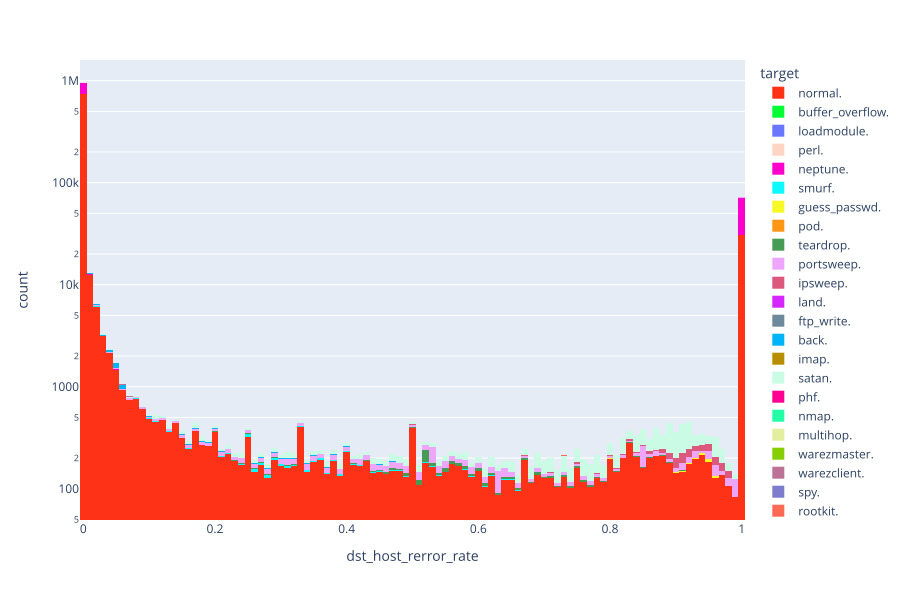

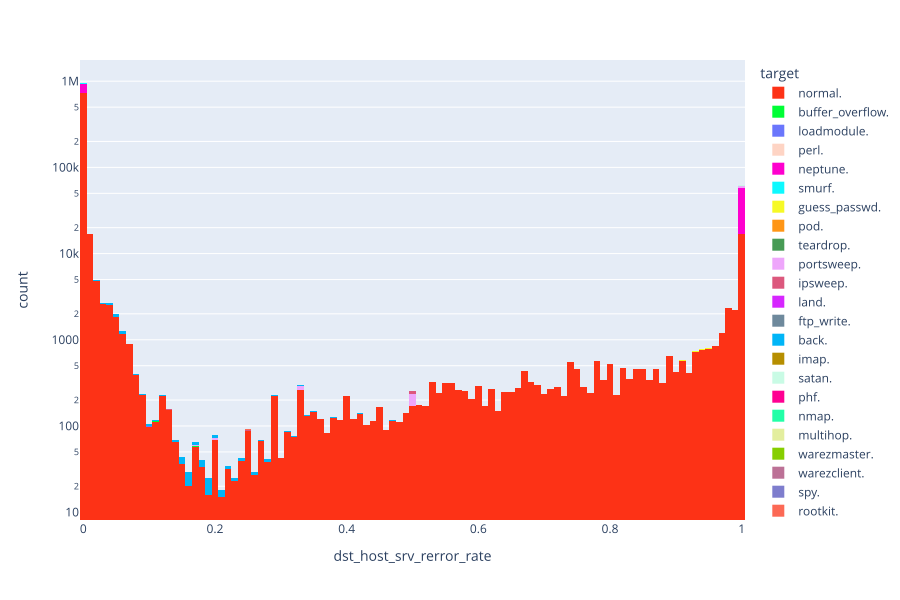

In [16]:
for feature_name in df_continuous_cols:
    fig = px.histogram(df, x=feature_name, log_y=True, color="target", color_discrete_sequence=px.colors.qualitative.Light24)
    fig.show(renderer="svg", width=900, height=600)

### Plotting feature correlation matrices

In [17]:
def log1p_sorted_abs_feature_correlation_matrix(df):
    corr_df = df.corr()
    corr_df.dropna(axis=0, how='all', inplace=True)
    corr_df.dropna(axis=1, how='all', inplace=True)
    corr_df = corr_df.abs()

    # sort both axis:
    corr_df = corr_df.pipe(lambda df: df.loc[:, df.sum().sort_values(ascending=False).index]).transpose(
        ).pipe(lambda df: df.loc[:, df.sum().sort_values(ascending=False).index]).transpose()

    corr_df = corr_df.apply(lambda x: np.log1p(x))

    return corr_df

def plot_modified_correlation_matrix(df, title):
    fig = px.imshow(log1p_sorted_abs_feature_correlation_matrix(df), title=title)
    fig.show(renderer='svg', width=900, height=900)

### Overall feature correlation matrices

/tmp/ipykernel_7218/3574190239.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



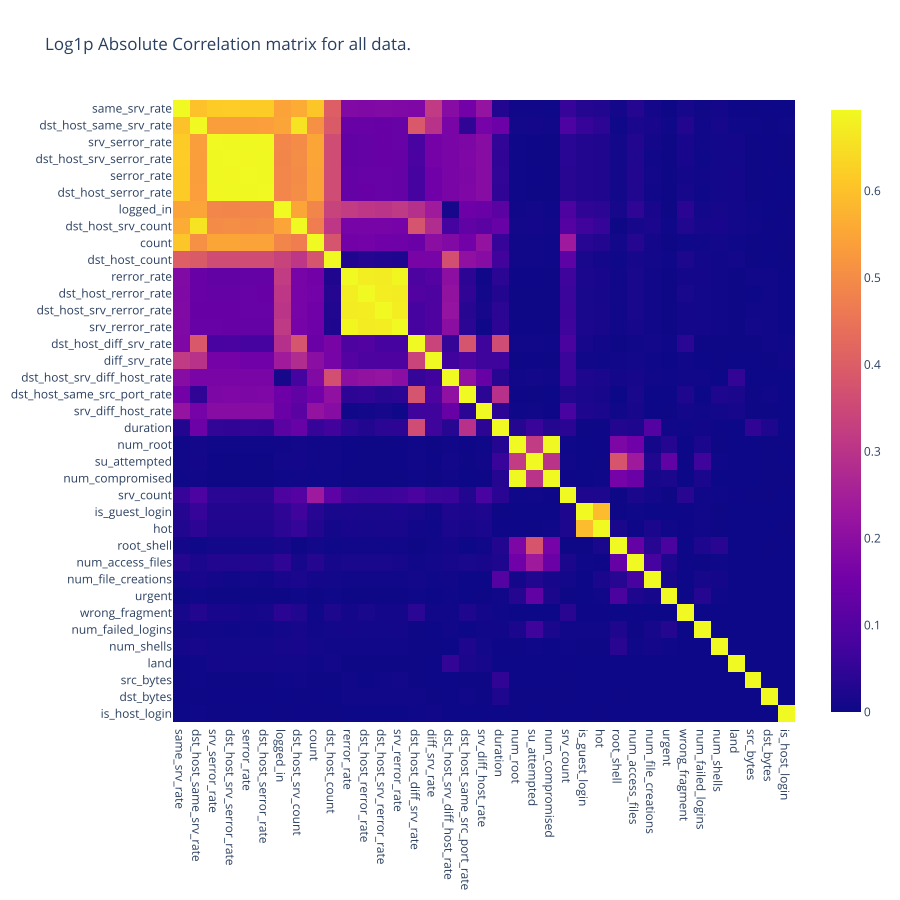

In [18]:
plot_modified_correlation_matrix(df, f"Log1p Absolute Correlation matrix for all data.")

### Label-wise feature correlation matrices

/tmp/ipykernel_7218/3574190239.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



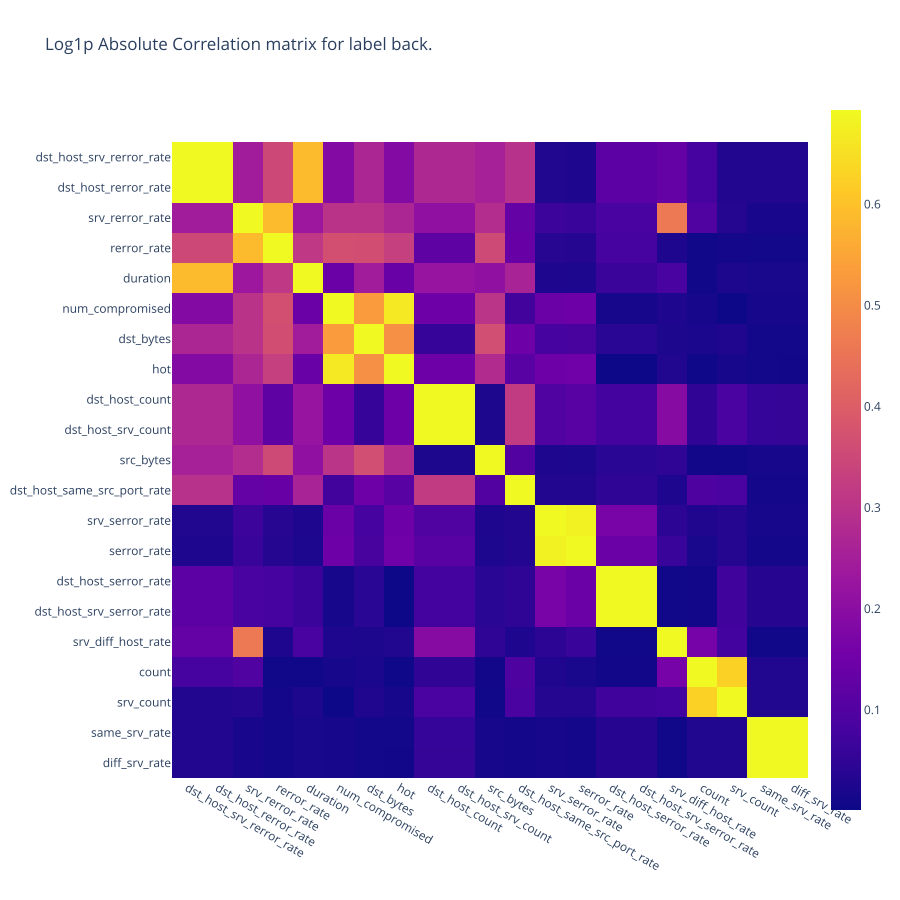

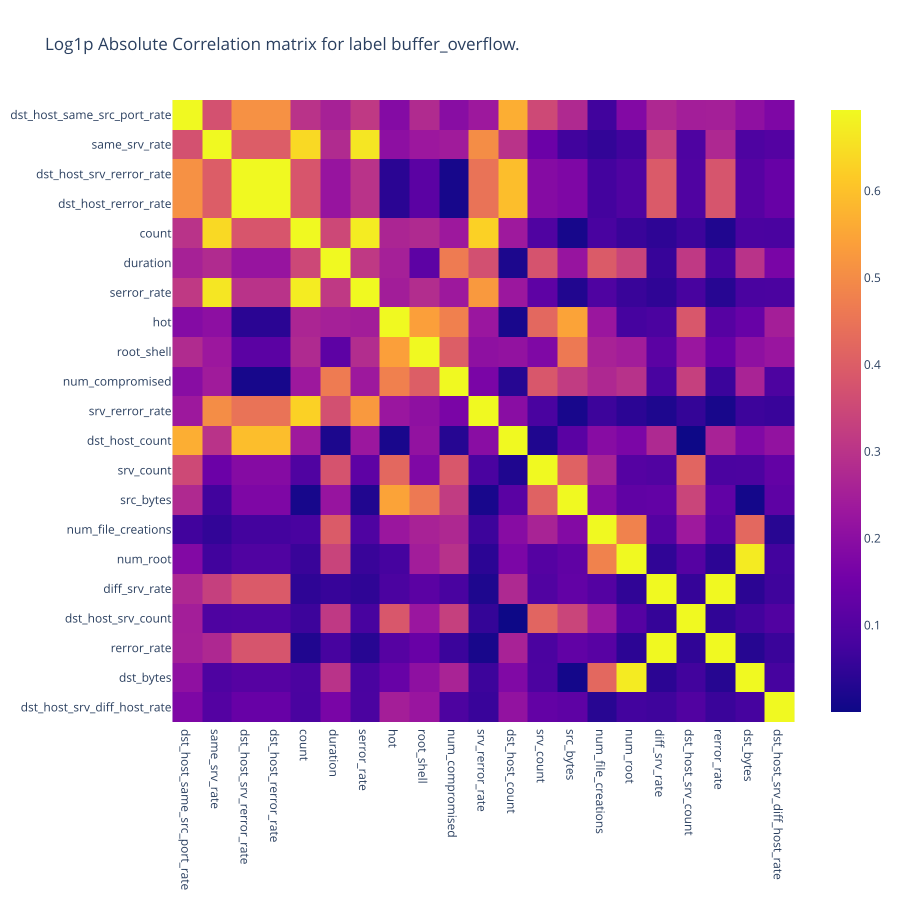

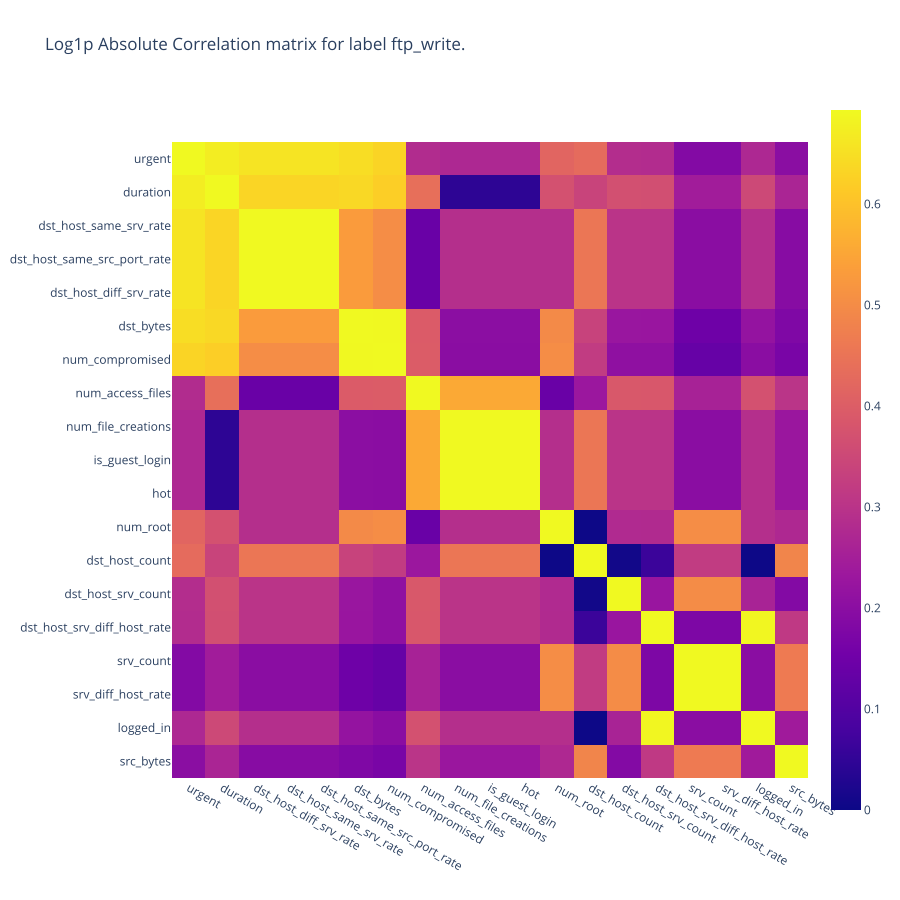

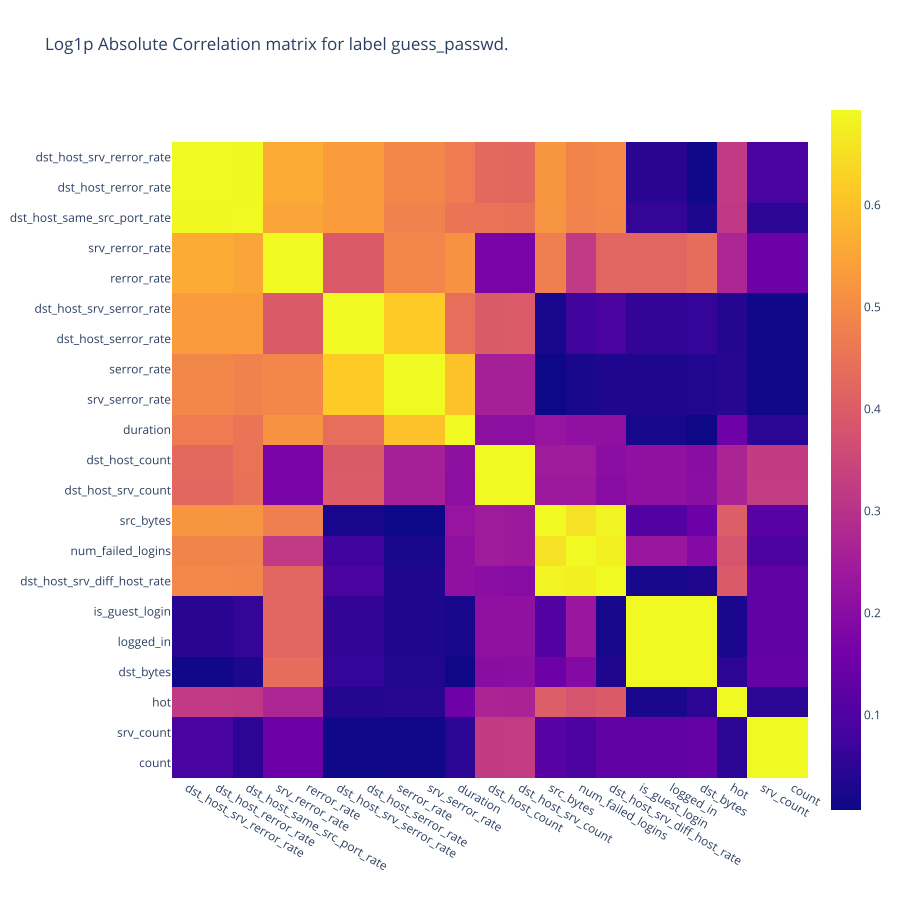

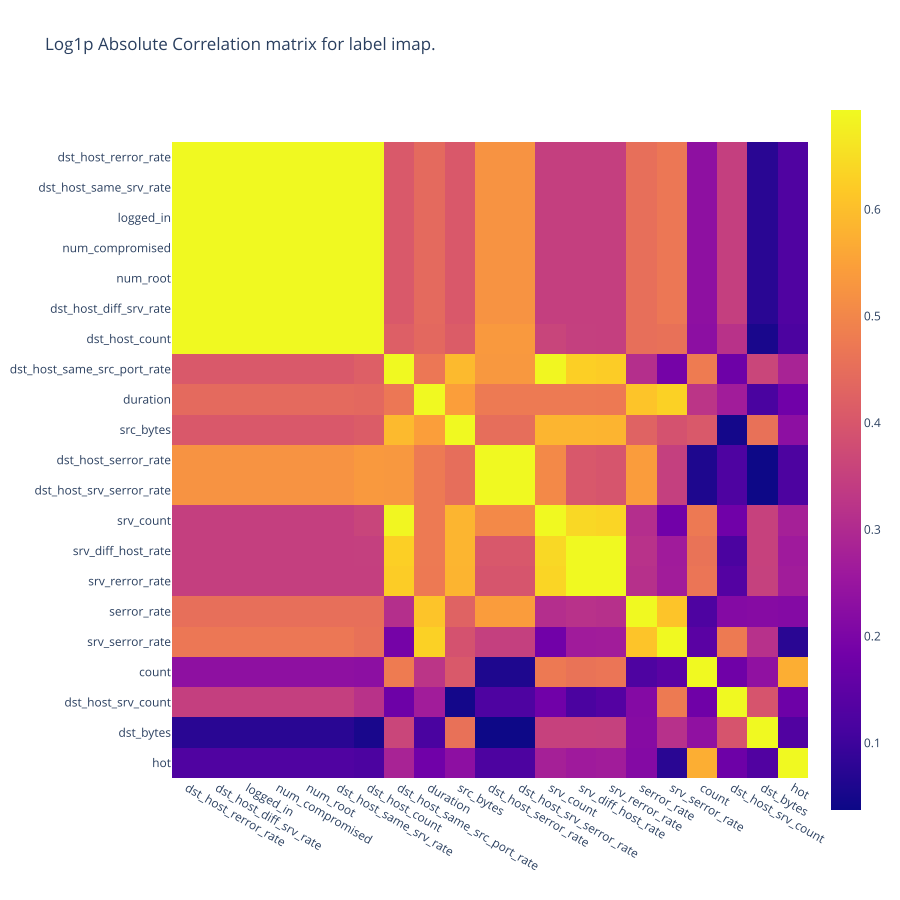

...

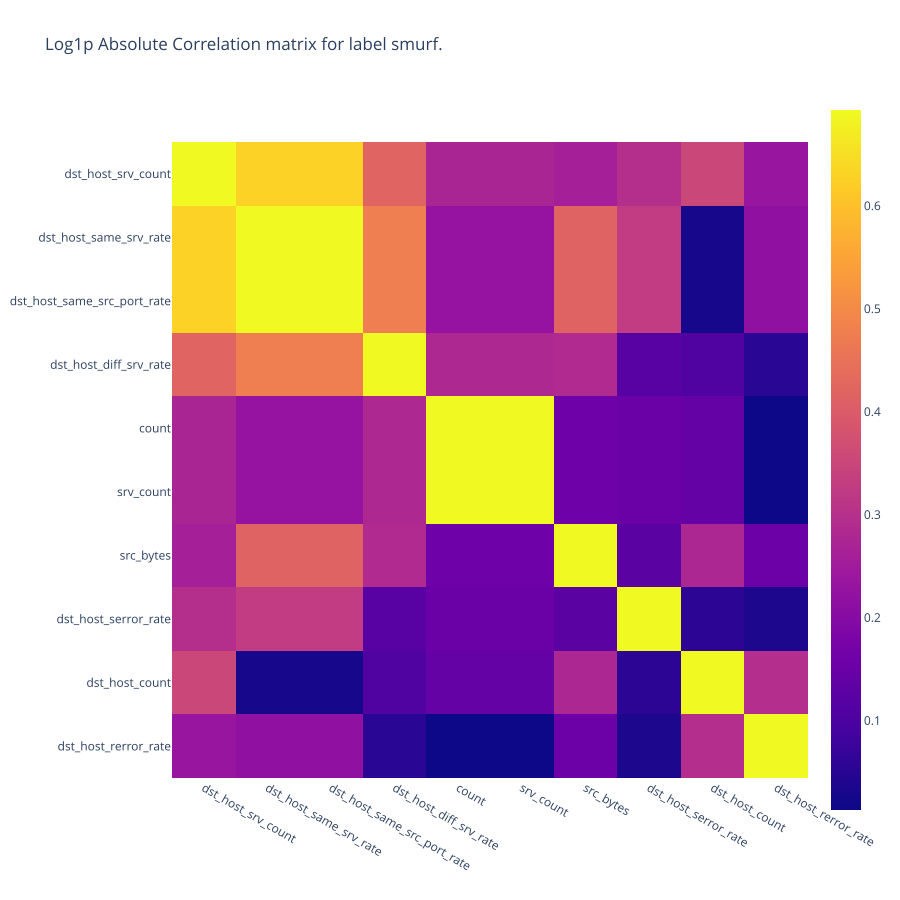

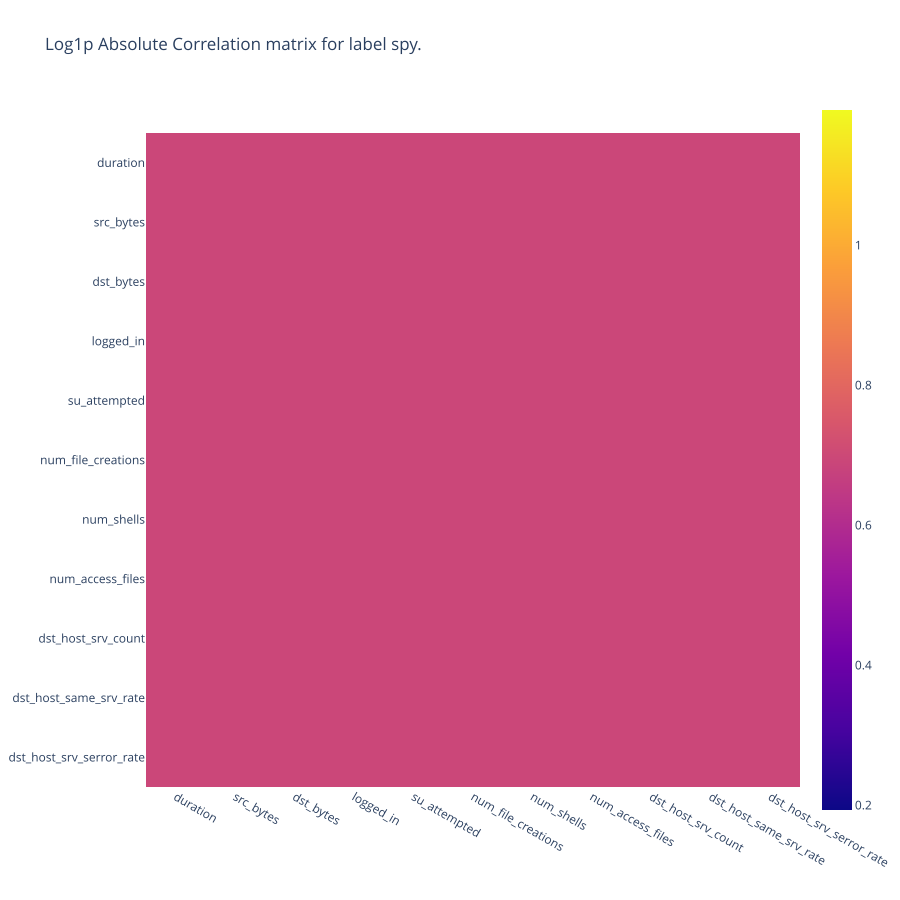

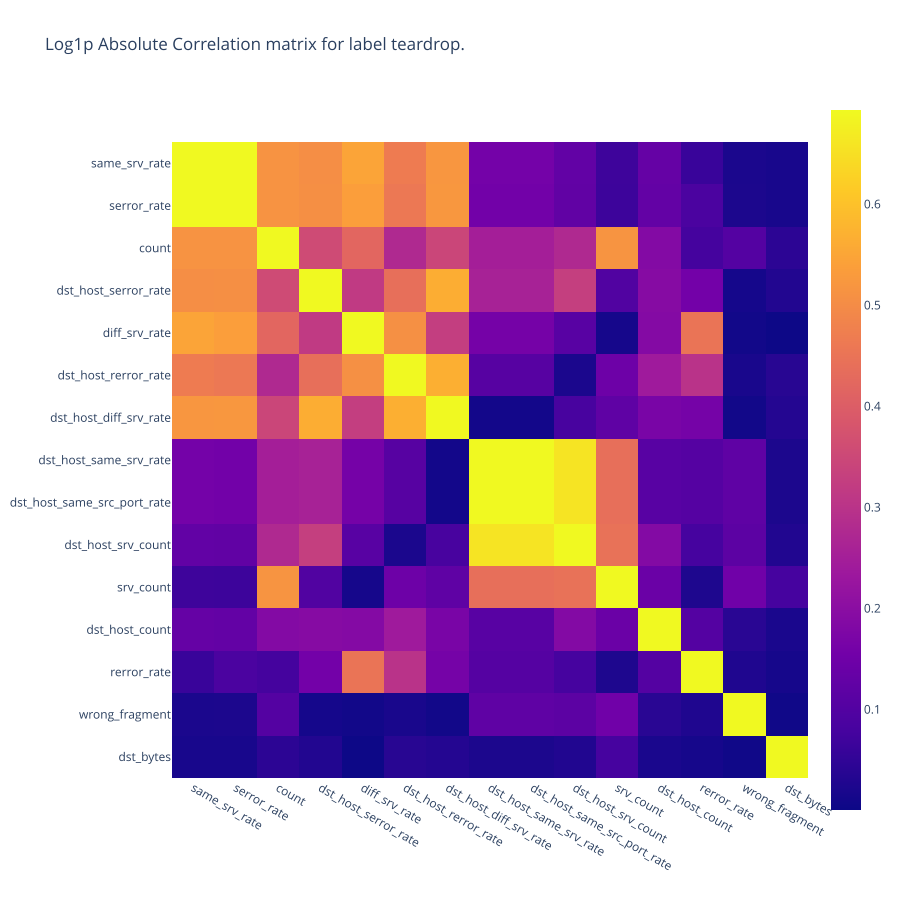

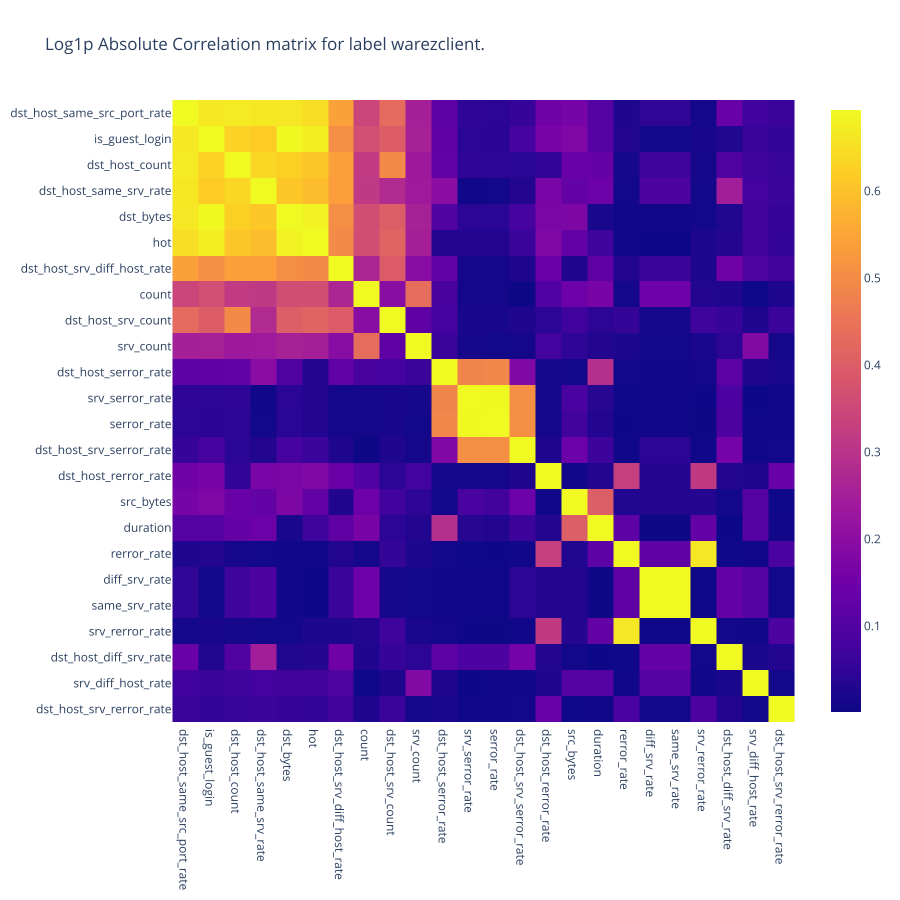

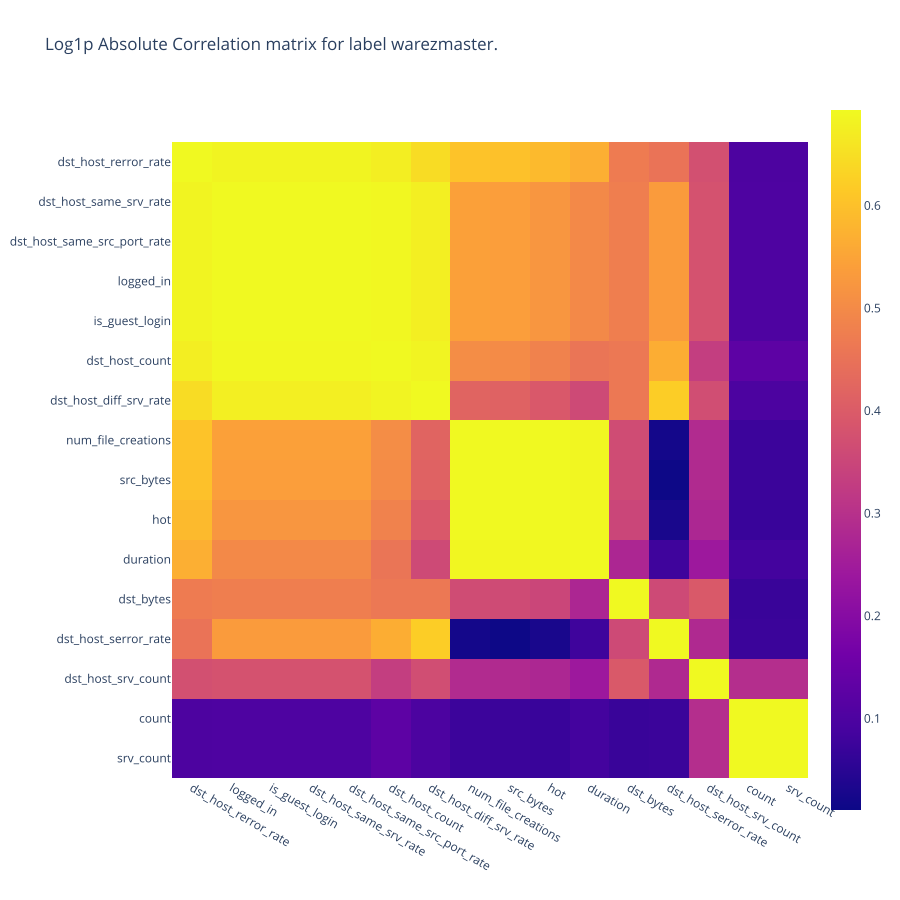

In [19]:
# Correlation matrix per isolated label:

for label, label_df in intact_df_per_label.items():
    plot_modified_correlation_matrix(label_df, f"Log1p Absolute Correlation matrix for label {label}")

## Plotting feature importance by fitting trees

Fitting trees on the data can yield easy measures of the importance of every metric. For a detailed example, check out this [Decision Trees For Knowledge Discovery](https://github.com/Vooban/Decision-Trees-For-Knowledge-Discovery) post that I've made in 2017. 

The general idea is applied again here to discover which features are the most important. The analysis is done firstly on the global dataset, then label-wise.


In [20]:
from sklearn.tree import DecisionTreeClassifier

In [21]:
def plot_feature_importance(df, title, title2=None, max_tree_depth=15, plot_top_2=False):
    clf = DecisionTreeClassifier(max_depth=max_tree_depth)
    X = df[df_continuous_cols].values[:, :-1]
    y = df.values[:, -1]
    clf = clf.fit(X, y)

    feature_importance_df = pd.DataFrame(list(zip(clf.feature_importances_, feature_names)), columns=["feature_importance", "feature_name"])
    feature_importance_df = feature_importance_df.sort_values(by='feature_importance', ascending=False)
    useless_features = list(feature_importance_df[feature_importance_df['feature_importance'] == 0]['feature_name'])
    feature_importance_df = feature_importance_df[feature_importance_df['feature_importance'] != 0]

    fig = px.bar(feature_importance_df, x="feature_name", y="feature_importance", log_y=True, title=title)
    fig.show(renderer='svg', width=900, height=500)
    
    print("The following features were dropped:")
    print(useless_features)
    
    top_features = feature_importance_df['feature_name']  # TODO: if feature in continuous_features
    if plot_top_2:
        if len(top_features) >= 2:
            fig = px.scatter(
                df, x=top_features.iloc[0], y=top_features.iloc[1],
                title=title2,
                color="target", color_discrete_sequence=px.colors.qualitative.Light24,
                symbol="target", symbol_sequence=["asterisk-open"])
            # fig = px.scatter_3d(..., z=top_features.iloc[2], ...)
            fig.show(renderer='jpg', width=900, height=700)
        else:
            print("Sckipping feature importance scatterplot as there are less than 2 features.")


### Overall feature importance:

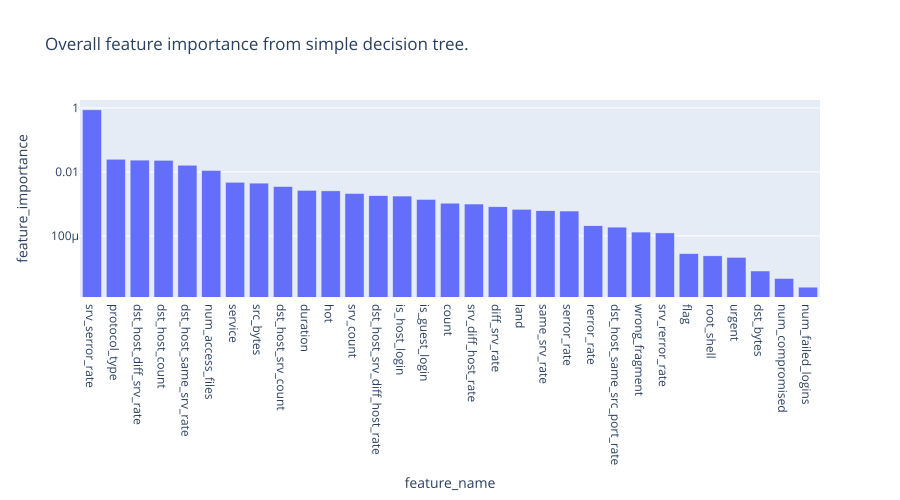

The following features were dropped as useless:
['num_shells', 'num_file_creations', 'logged_in', 'num_root', 'su_attempted']


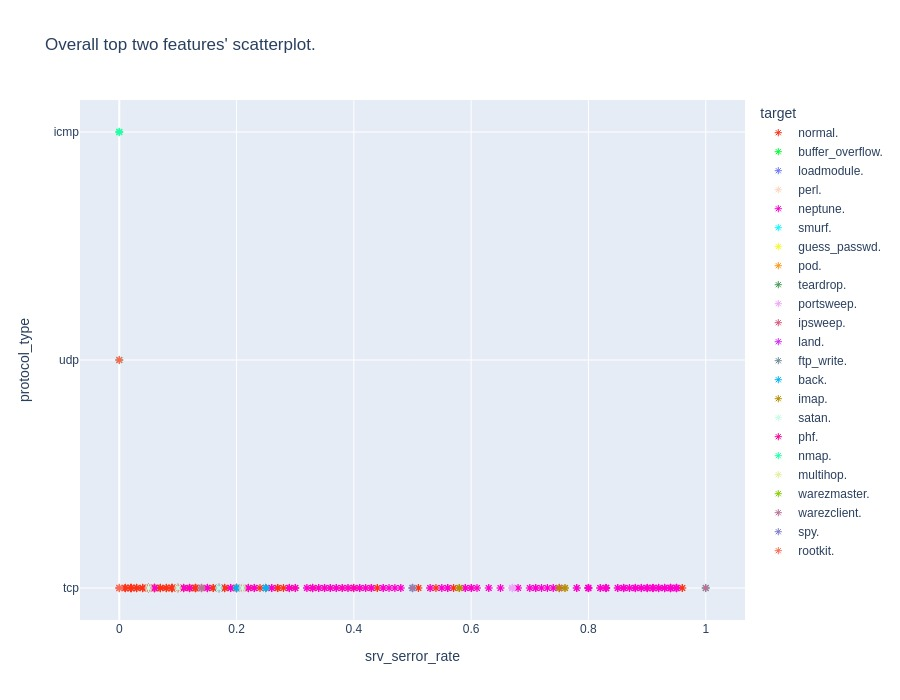

In [22]:
plot_feature_importance(df, "Overall feature importance from simple decision tree.", "Overall top two features' scatterplot.", plot_top_2=True)

### Label-wise feature importance

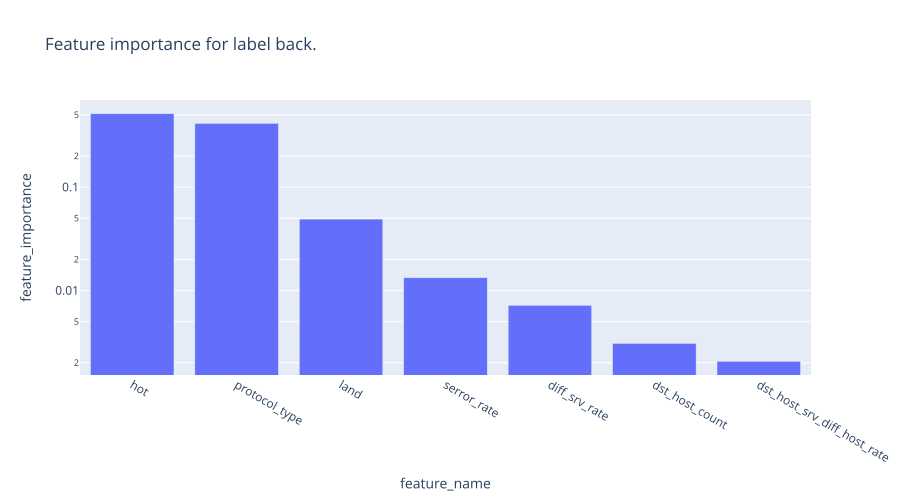

The following features were dropped as useless:
['dst_host_srv_count', 'srv_diff_host_rate', 'is_guest_login', 'dst_host_diff_srv_rate', 'same_srv_rate', 'srv_rerror_rate', 'rerror_rate', 'srv_serror_rate', 'dst_host_same_srv_rate', 'srv_count', 'count', 'dst_host_same_src_port_rate', 'duration', 'is_host_login', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'num_failed_logins', 'urgent', 'wrong_fragment', 'dst_bytes', 'src_bytes', 'flag', 'service', 'num_access_files']


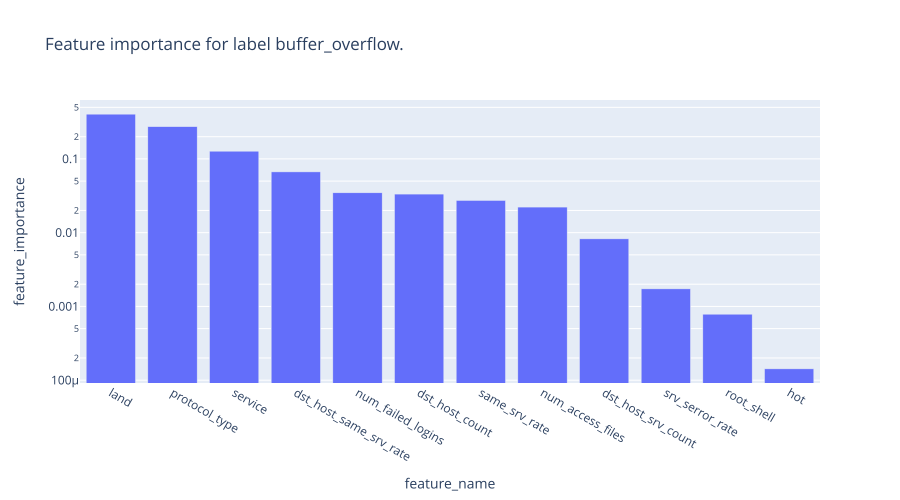

The following features were dropped as useless:
['count', 'srv_diff_host_rate', 'diff_srv_rate', 'dst_host_diff_srv_rate', 'srv_rerror_rate', 'rerror_rate', 'dst_host_same_src_port_rate', 'serror_rate', 'srv_count', 'duration', 'is_guest_login', 'is_host_login', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'num_compromised', 'logged_in', 'urgent', 'wrong_fragment', 'dst_bytes', 'src_bytes', 'flag', 'dst_host_srv_diff_host_rate']


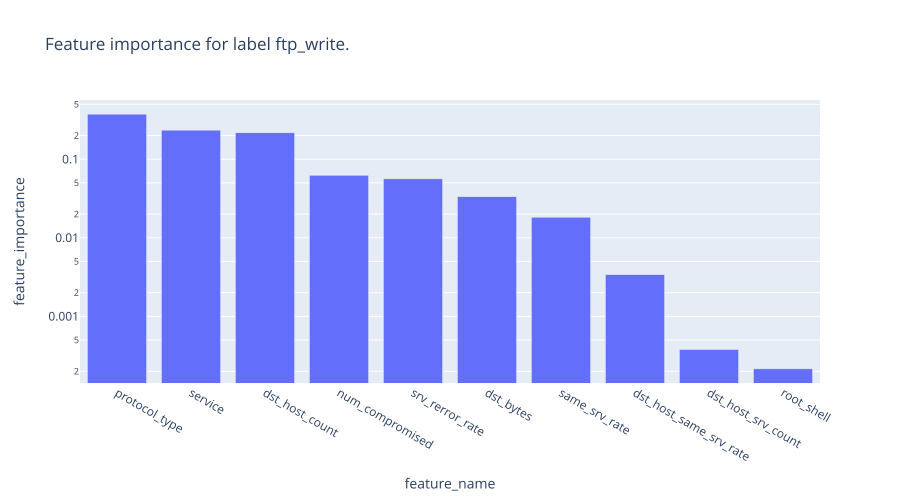

The following features were dropped as useless:
['duration', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'diff_srv_rate', 'count', 'srv_diff_host_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'srv_count', 'num_access_files', 'is_guest_login', 'is_host_login', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'logged_in', 'num_failed_logins', 'hot', 'urgent', 'wrong_fragment', 'land', 'src_bytes', 'flag', 'dst_host_srv_diff_host_rate']


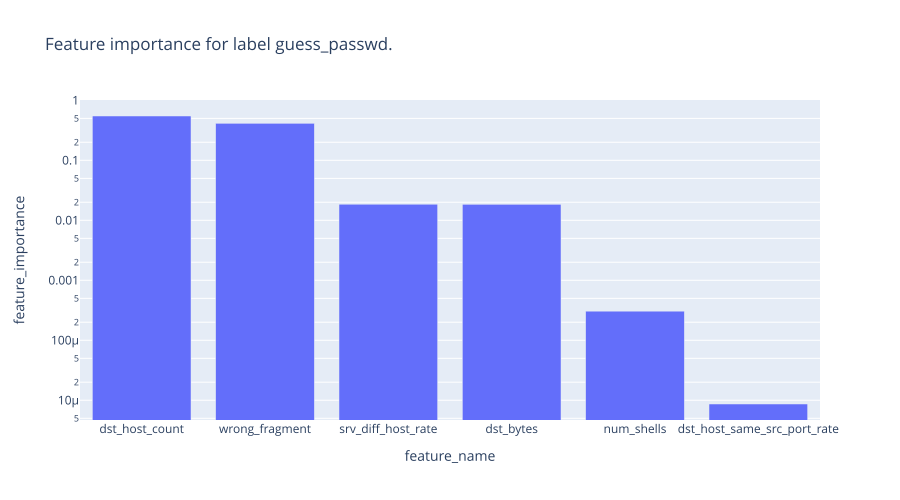

The following features were dropped as useless:
['srv_rerror_rate', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'duration', 'same_srv_rate', 'diff_srv_rate', 'is_guest_login', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'count', 'num_access_files', 'is_host_login', 'protocol_type', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'num_failed_logins', 'hot', 'urgent', 'land', 'src_bytes', 'flag', 'service', 'dst_host_srv_diff_host_rate']


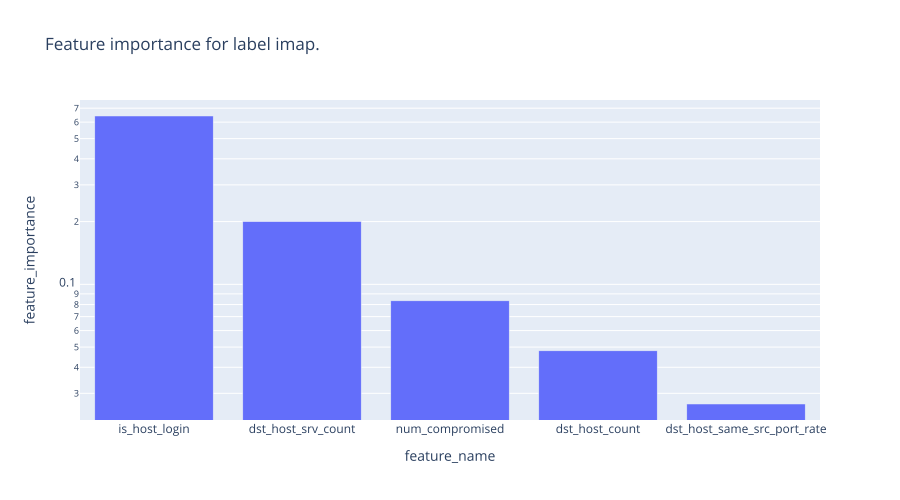

The following features were dropped as useless:
['duration', 'rerror_rate', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'same_srv_rate', 'srv_rerror_rate', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'is_guest_login', 'num_access_files', 'protocol_type', 'urgent', 'service', 'flag', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment', 'hot', 'num_shells', 'num_failed_logins', 'logged_in', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'dst_host_srv_diff_host_rate']


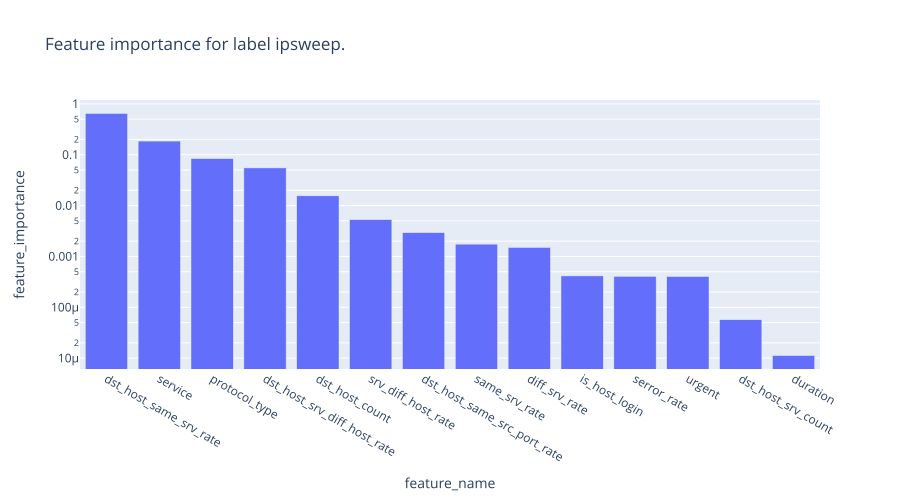

The following features were dropped as useless:
['su_attempted', 'num_root', 'flag', 'dst_host_diff_srv_rate', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment', 'hot', 'num_failed_logins', 'srv_rerror_rate', 'rerror_rate', 'srv_serror_rate', 'logged_in', 'srv_count', 'count', 'is_guest_login', 'num_compromised', 'root_shell', 'num_shells', 'num_file_creations', 'num_access_files']


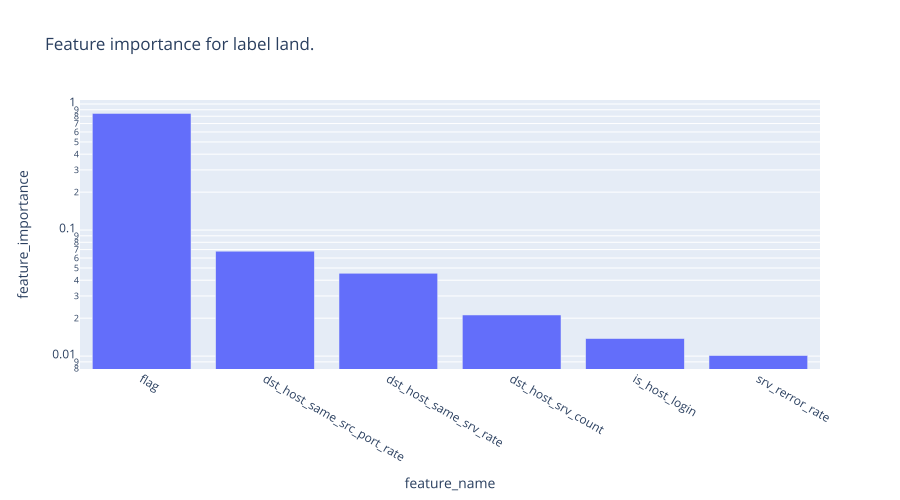

The following features were dropped as useless:
['duration', 'rerror_rate', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'diff_srv_rate', 'same_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_diff_srv_rate', 'is_guest_login', 'num_access_files', 'protocol_type', 'hot', 'service', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'num_failed_logins', 'num_shells', 'logged_in', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'dst_host_srv_diff_host_rate']


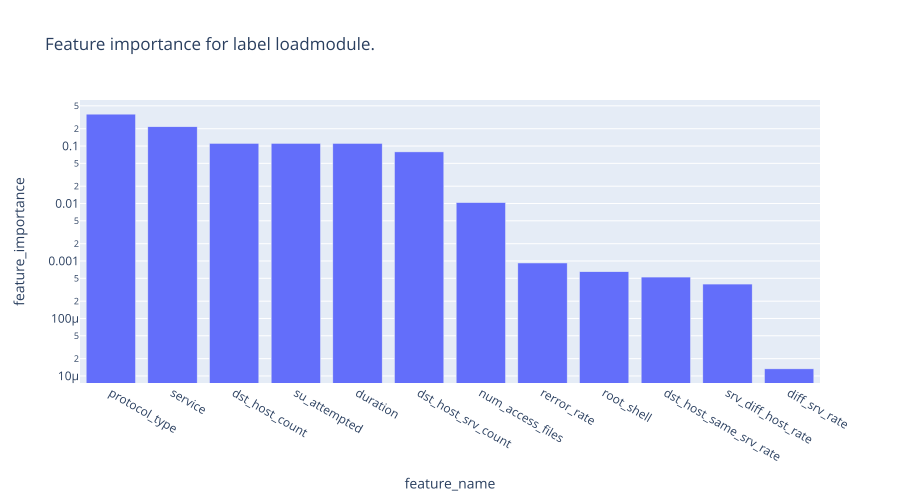

The following features were dropped as useless:
['wrong_fragment', 'srv_count', 'dst_host_same_src_port_rate', 'dst_host_diff_srv_rate', 'flag', 'src_bytes', 'same_srv_rate', 'srv_rerror_rate', 'srv_serror_rate', 'serror_rate', 'count', 'urgent', 'is_guest_login', 'is_host_login', 'dst_bytes', 'num_shells', 'num_file_creations', 'num_root', 'land', 'num_compromised', 'logged_in', 'num_failed_logins', 'hot', 'dst_host_srv_diff_host_rate']


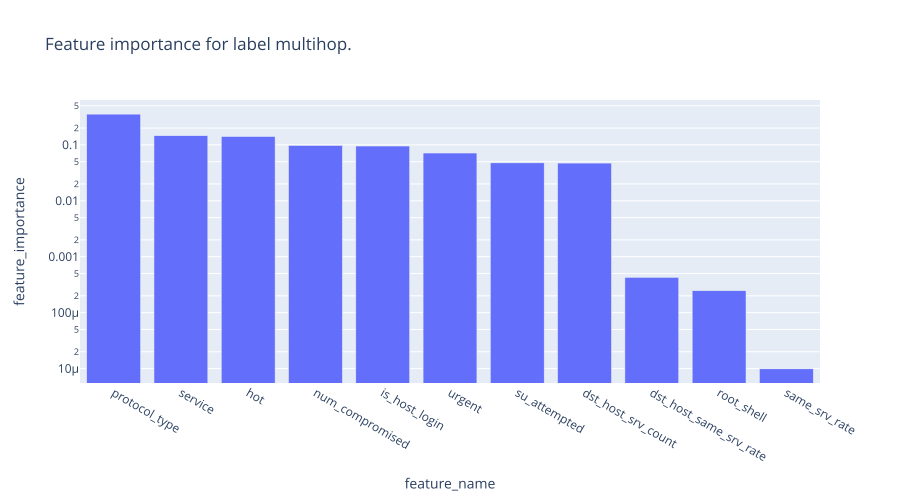

The following features were dropped as useless:
['duration', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'diff_srv_rate', 'srv_count', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'serror_rate', 'num_access_files', 'count', 'is_guest_login', 'num_shells', 'num_file_creations', 'num_root', 'logged_in', 'num_failed_logins', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'dst_host_srv_diff_host_rate']


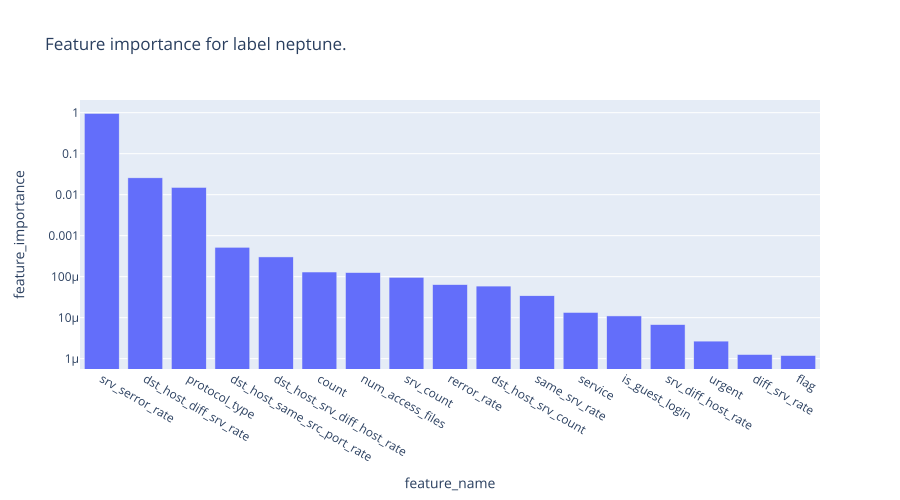

The following features were dropped as useless:
['wrong_fragment', 'serror_rate', 'dst_host_same_srv_rate', 'dst_host_count', 'srv_rerror_rate', 'src_bytes', 'dst_bytes', 'is_host_login', 'land', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'num_failed_logins', 'hot', 'duration']


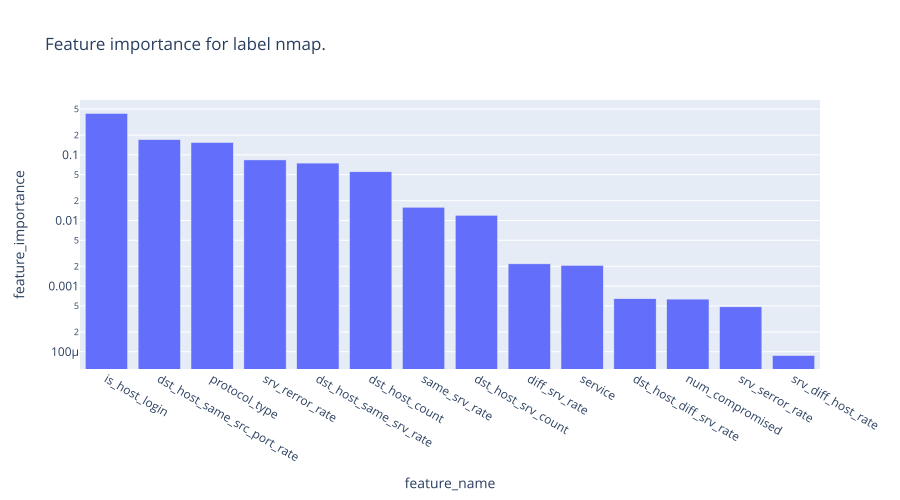

The following features were dropped as useless:
['is_guest_login', 'rerror_rate', 'serror_rate', 'srv_count', 'count', 'duration', 'num_access_files', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'logged_in', 'num_failed_logins', 'hot', 'urgent', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'dst_host_srv_diff_host_rate']


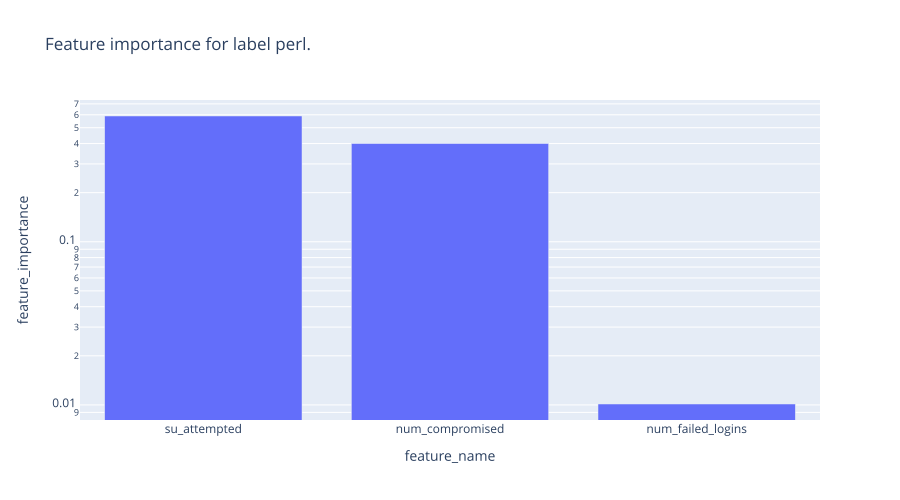

The following features were dropped as useless:
['duration', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate', 'is_guest_login', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'count', 'num_access_files', 'is_host_login', 'protocol_type', 'num_shells', 'num_file_creations', 'num_root', 'root_shell', 'logged_in', 'hot', 'urgent', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'service', 'dst_host_srv_diff_host_rate']


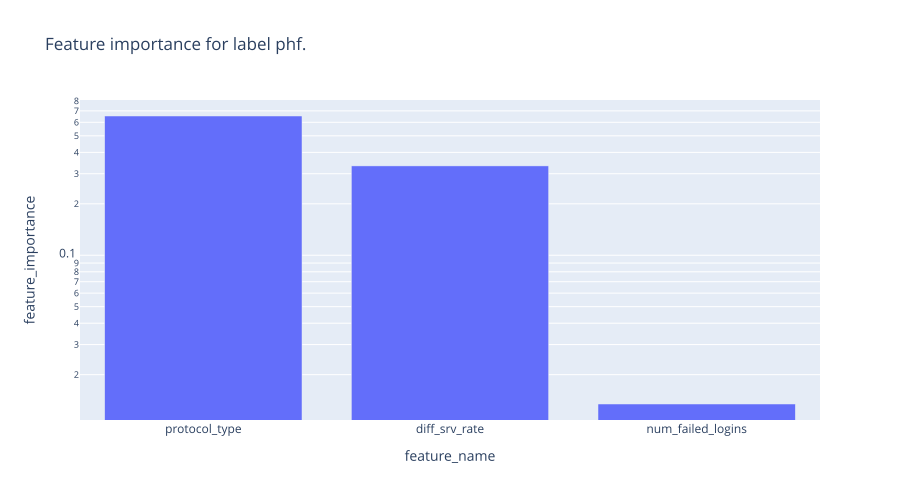

The following features were dropped as useless:
['is_guest_login', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'duration', 'is_host_login', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'same_srv_rate', 'num_access_files', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'hot', 'urgent', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'service', 'dst_host_srv_diff_host_rate']


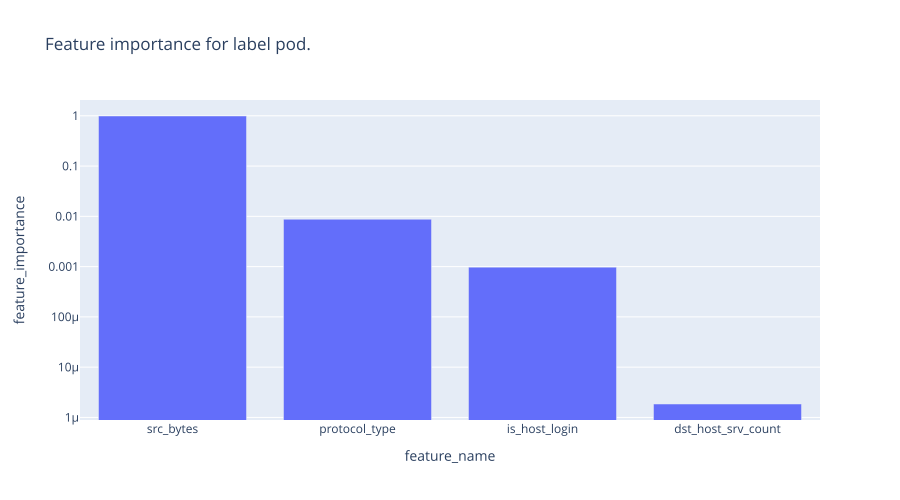

The following features were dropped as useless:
['srv_rerror_rate', 'is_guest_login', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'duration', 'same_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'diff_srv_rate', 'num_access_files', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'num_failed_logins', 'hot', 'urgent', 'wrong_fragment', 'land', 'dst_bytes', 'flag', 'service', 'dst_host_srv_diff_host_rate']


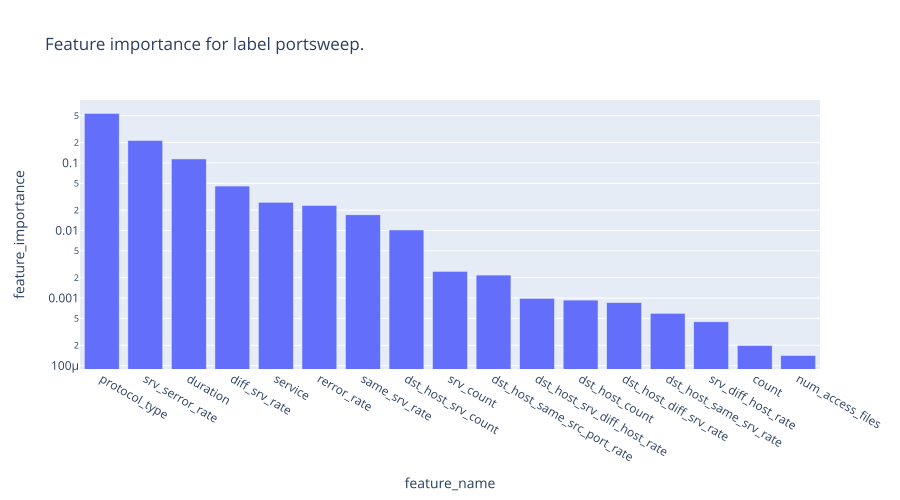

The following features were dropped as useless:
['urgent', 'flag', 'src_bytes', 'dst_bytes', 'land', 'srv_rerror_rate', 'wrong_fragment', 'logged_in', 'num_compromised', 'hot', 'is_guest_login', 'is_host_login', 'num_failed_logins', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'serror_rate']


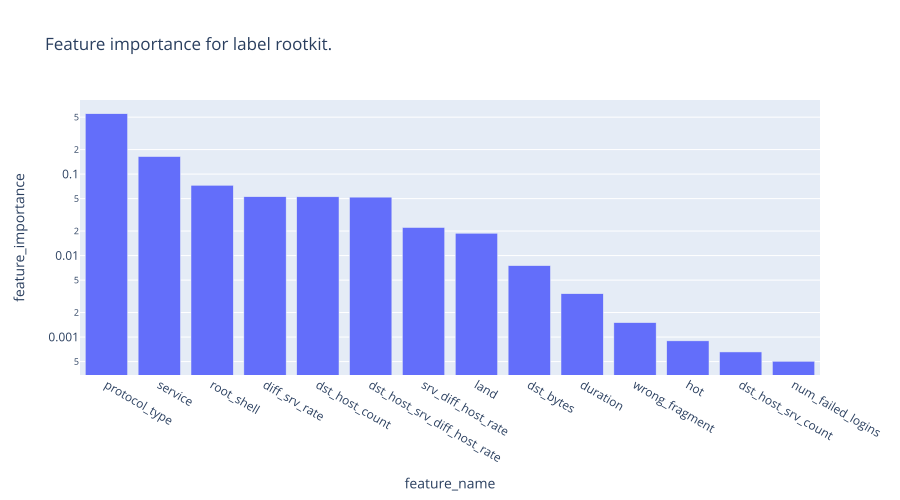

The following features were dropped as useless:
['srv_serror_rate', 'dst_host_same_src_port_rate', 'dst_host_diff_srv_rate', 'dst_host_same_srv_rate', 'flag', 'src_bytes', 'same_srv_rate', 'srv_rerror_rate', 'rerror_rate', 'serror_rate', 'logged_in', 'srv_count', 'count', 'is_guest_login', 'is_host_login', 'urgent', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'num_compromised', 'num_access_files']


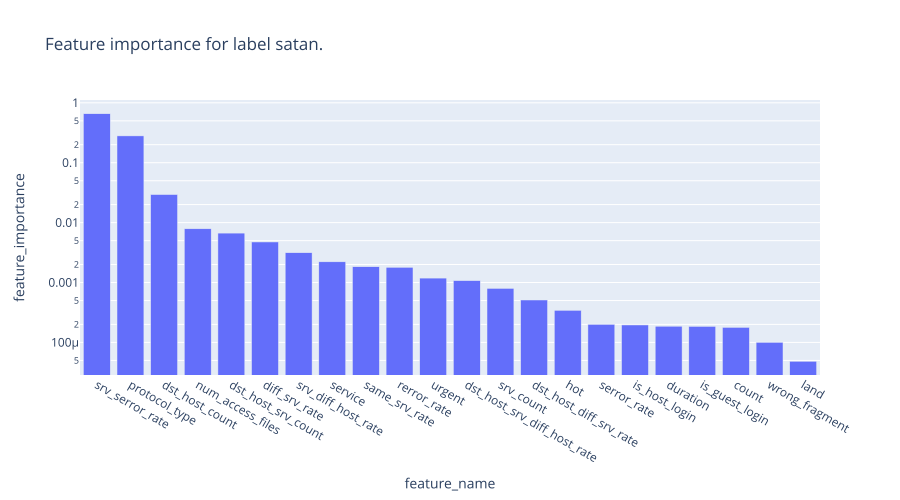

The following features were dropped as useless:
['dst_host_same_src_port_rate', 'dst_host_same_srv_rate', 'flag', 'src_bytes', 'dst_bytes', 'num_compromised', 'srv_rerror_rate', 'root_shell', 'logged_in', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'num_failed_logins']


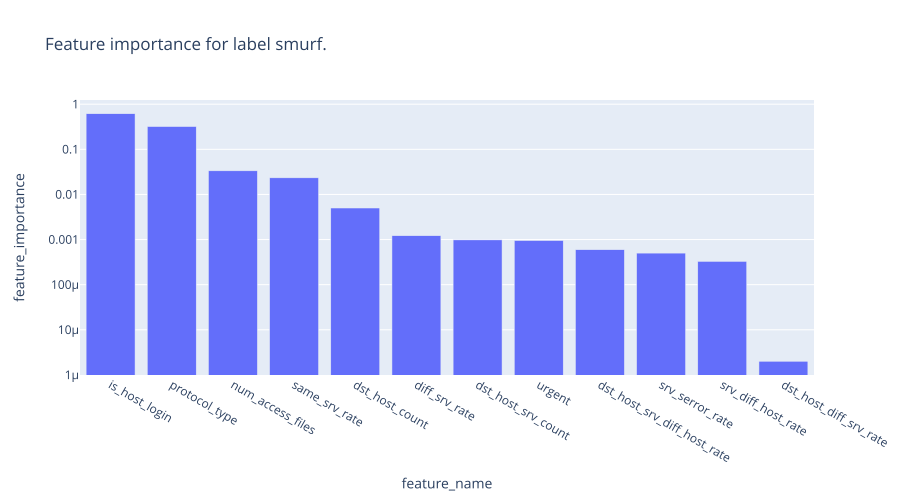

The following features were dropped as useless:
['hot', 'serror_rate', 'dst_host_same_src_port_rate', 'dst_host_same_srv_rate', 'service', 'flag', 'src_bytes', 'dst_bytes', 'srv_rerror_rate', 'rerror_rate', 'srv_count', 'num_failed_logins', 'count', 'is_guest_login', 'land', 'wrong_fragment', 'num_shells', 'num_file_creations', 'num_root', 'su_attempted', 'root_shell', 'num_compromised', 'logged_in', 'duration']


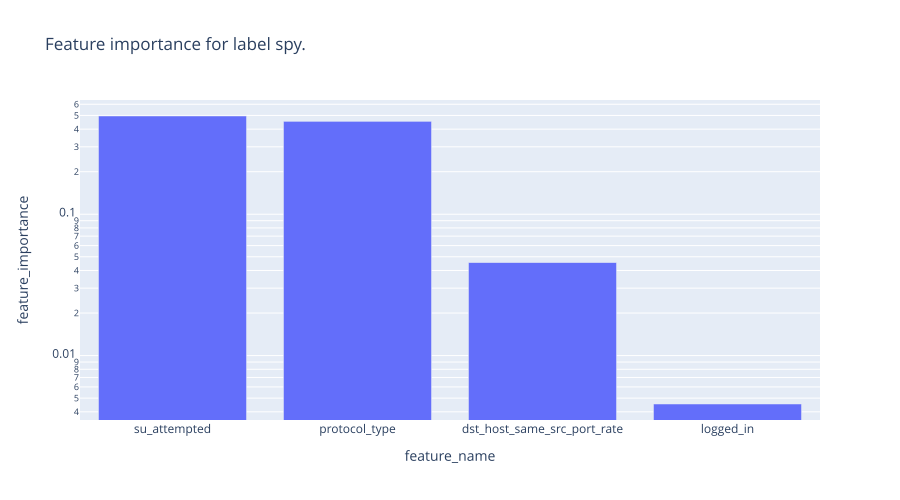

The following features were dropped as useless:
['srv_rerror_rate', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'duration', 'is_guest_login', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'same_srv_rate', 'num_access_files', 'is_host_login', 'num_shells', 'num_file_creations', 'num_root', 'root_shell', 'num_compromised', 'num_failed_logins', 'hot', 'urgent', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'service', 'dst_host_srv_diff_host_rate']


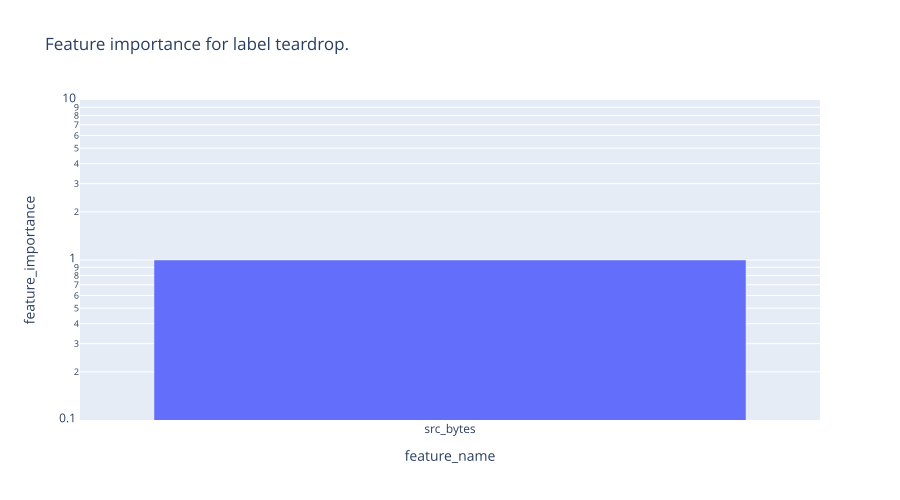

The following features were dropped as useless:
['duration', 'same_srv_rate', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'diff_srv_rate', 'is_host_login', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'is_guest_login', 'num_access_files', 'protocol_type', 'hot', 'service', 'flag', 'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'num_failed_logins', 'num_shells', 'logged_in', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'dst_host_srv_diff_host_rate']


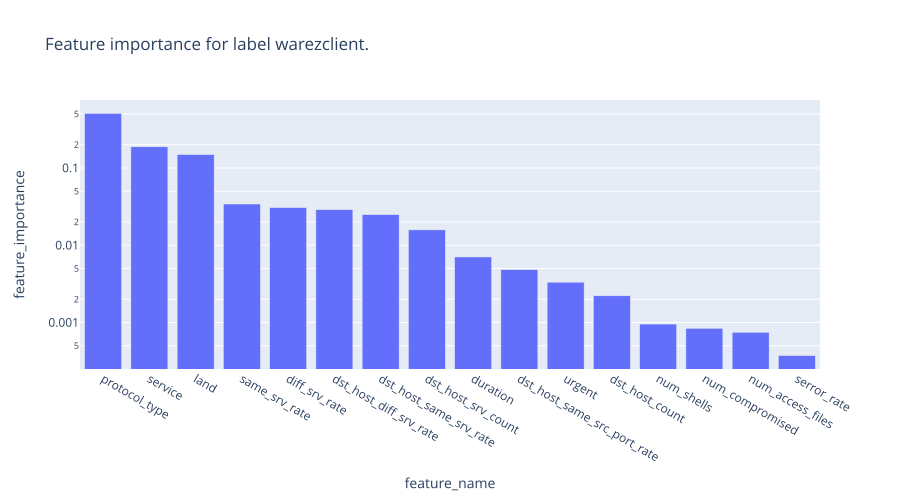

The following features were dropped as useless:
['num_root', 'srv_rerror_rate', 'flag', 'src_bytes', 'dst_bytes', 'wrong_fragment', 'hot', 'srv_diff_host_rate', 'num_failed_logins', 'logged_in', 'rerror_rate', 'num_file_creations', 'srv_serror_rate', 'srv_count', 'count', 'is_guest_login', 'is_host_login', 'root_shell', 'su_attempted', 'dst_host_srv_diff_host_rate']


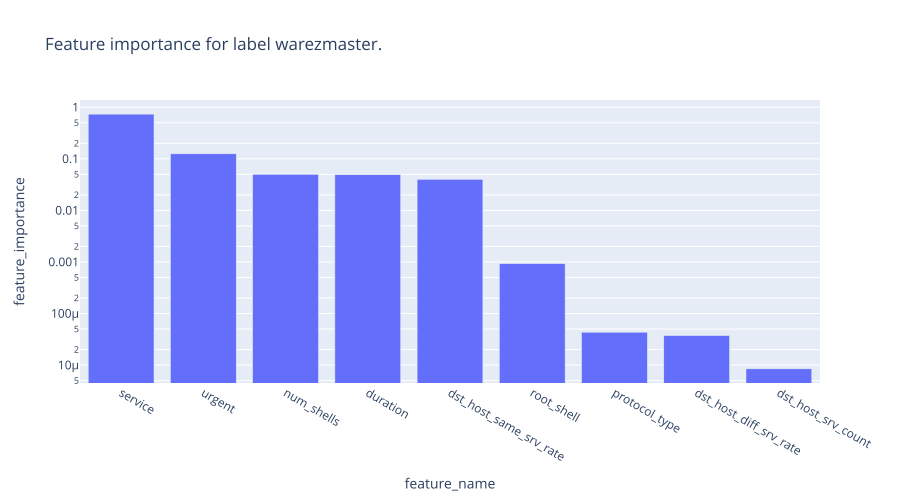

The following features were dropped as useless:
['serror_rate', 'srv_serror_rate', 'rerror_rate', 'diff_srv_rate', 'srv_rerror_rate', 'same_srv_rate', 'count', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_same_src_port_rate', 'srv_count', 'num_access_files', 'is_guest_login', 'is_host_login', 'num_file_creations', 'num_root', 'su_attempted', 'num_compromised', 'logged_in', 'num_failed_logins', 'hot', 'wrong_fragment', 'land', 'dst_bytes', 'src_bytes', 'flag', 'dst_host_srv_diff_host_rate']


In [23]:
for label, label_df in with_normal_df_per_label.items():
    plot_feature_importance(label_df, f"Feature importance for label {label}")

## Anomaly detection by fitting normal traffic

Here, we will use the [Isolation Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) provided in scikit-learn to fit the traffic labelled as "normal" and then see what are the anomalies in that traffic. 

Using this same fitted forest, then the analysis will be done on all the rest of the data.

Note that the Isolation Forest here is not even tuned and a value of 100 as a number of samples is taken, similarily as what is done in [Batea](https://github.com/delvelabs/batea). 


In [24]:
symbolic_features

['protocol_type', 'service', 'flag']

In [25]:
# transform categorical features to numerical ones. 

def categorical_df_to_numerical_one_hot(df):
    df_one_hot = df.copy()

    for sf_name in reversed(symbolic_features):
        dum = pd.get_dummies(df[sf_name])
        dum.columns = sf_name + "__" + dum.columns.map(str)

        df_one_hot = pd.concat([dum, df_one_hot], axis=1)
        df_one_hot.drop([sf_name], axis=1, inplace=True)

    return df_one_hot

df_one_hot = categorical_df_to_numerical_one_hot(df)
df_one_hot.columns

Index(['protocol_type__icmp', 'protocol_type__tcp', 'protocol_type__udp',
       'service__IRC', 'service__X11', 'service__Z39_50', 'service__aol',
       'service__auth', 'service__bgp', 'service__courier',
       ...
       'dst_host_srv_count', 'dst_host_same_srv_rate',
       'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'dst_host_rerror_rate',
       'dst_host_srv_rerror_rate', 'target'],
      dtype='object', length=122)

Let's preprocess the data by splitting it into X and y.

In [26]:
from neuraxle.base import BaseStep
from sklearn.preprocessing import StandardScaler


class DFPreprocessor(BaseStep):
    def __init__(self):
        self.rescaler = StandardScaler()

    def _preprocess(self, df):
        Y = df.values[:, -1]
        X = df.values[:, 0:-1]
        Y = Y.reshape(-1, 1)
        return X, Y
        
    def fit(self, df, _=None):
        X, Y = self._preprocess(df)
        X = self.rescaler.fit(X)
        return X, Y

    def transform(self, df, _=None):
        X, Y = self._preprocess(df)
        X = self.rescaler.transform(X)
        return X, Y

In [27]:
preproc = DFPreprocessor()

df_normal_numerical = df_one_hot.copy()[df_one_hot.target == "normal."]
df_without_normal_numerical = df_one_hot.copy()[df_one_hot.target != "normal."]

df_normal_numerical.shape, df_without_normal_numerical.shape

((812814, 122), (262178, 122))

### Fit normal traffic

Let's fit an isolation forest on the normal data.

In [28]:
preproc.fit(df_normal_numerical)

X, y = preproc.transform(df_one_hot)
X_train, y_train = preproc.transform(df_normal_numerical)
X_anomalies, y_anomalies = preproc.transform(df_without_normal_numerical)

In [29]:
from sklearn.ensemble import IsolationForest

isf = IsolationForest(max_samples=100)

X_subset = X_train[np.random.randint(X_train.shape[0], size=100), :]
isf.fit(X_subset)

y_pred_train = isf.predict(X_train)

### Check values for all traffic

In [30]:
y_pred_anomalies = isf.predict(X_anomalies)

In [31]:
y_pred = isf.predict(X)

In [40]:
from collections import Counter
print("1 is for traffic captured as normal, -1 is for an anomaly detected:")
("Train:", Counter(y_pred_train), "Test with actual anomalies:", Counter(y_pred_anomalies))

1 is for traffic captured as normal, -1 is for an anomaly detected.


('Train:',
 Counter({1: 734518, -1: 78296}),
 'Test with actual anomalies:',
 Counter({-1: 258050, 1: 4128}))

As we see above, the Train is mostly not anormal, and the anomalies are mostly detected. The above numbers are like a confusion matrix (todo: plot it)

### Plotting the detected anomalies

In [33]:
isf_df = df.copy()
isf_df['isf_pred'] = y_pred

In [34]:
size = isf_df.copy().groupby(["isf_pred", "target"]).size()

In [35]:
tot = size.loc[1].add(size.loc[-1], fill_value=0)

In [36]:
ss = pd.concat([size.loc[1], size.loc[-1]], axis=1).fillna(0)

In [37]:
ss_norm = pd.concat([size.loc[1].fillna(0) / tot * 100, size.loc[-1].fillna(0) / tot * 100], axis=1).fillna(0)
# Don't look at the variable names. Your eyes will bleed. Quick code.
ss = ss.rename(columns={0: "No Anomaly Detected", 1: "Anomaly Detected"})
ss_norm = ss_norm.rename(columns={0: "No Anomaly Detected", 1: "Anomaly Detected"}).round(decimals=0)
ss

,No Anomaly Detected,Anomaly Detected
target,,
back.,884.0,84.0
buffer_overflow.,23.0,7.0
ftp_write.,6.0,2.0
guess_passwd.,1.0,52.0
imap.,1.0,11.0
ipsweep.,641.0,3082.0
loadmodule.,5.0,4.0
multihop.,4.0,3.0
nmap.,298.0,1256.0


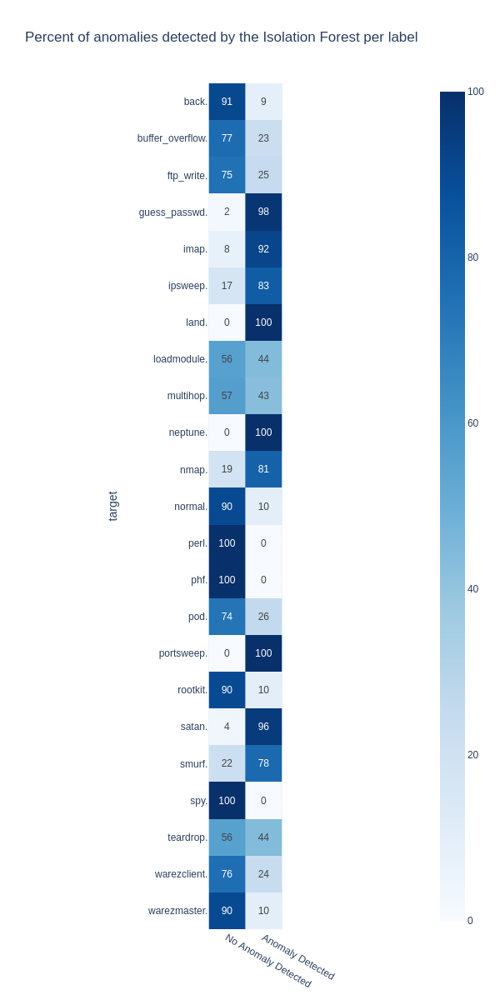

In [38]:
fig = px.imshow(
    ss_norm, text_auto=True, title="Percent of anomalies detected by the Isolation Forest per label",
    color_continuous_scale=px.colors.sequential.Blues
)
fig.show(renderer="png", width=600, height=1200)



We can see above that despite having never fitted on that earlier, we can automatically detect for some classes the anormal traffic. For normal traffic, 10% of it, however, is detected as anormal. This is interesting for a first shot at an unsupervised anomaly detection algorithm that was fitted on normal data. It should be possible to do way better.

That was cool!

## Improvement ideas

- Cleaning this code that is the least clean code I wrote in a while as of being in a hurry to mostly get some interesting visualizations
- Better dataset
  - More recent and actual real-life raw dataset, such as the [Stratosphere IPS Datasets](https://www.stratosphereips.org/datasets-overview)
  - More time series features than what is provided in kddcup99
  - Raw dataset would allow for doing more feature engineering
- Contextual features with a set of contextual connections to the device being watched
  - That could be done by drawing relationships between the connections of a device and other devices
  - These relationships could be seen as a set
  - Some metrics could crunch every relationships, such as using a 3D to 2D feature reducer in the context set, such as a `FeatureUnion([NumpyMean(), NumpyMedian(), NumpyMin(), NumpyMax()])` or an attention mechanism or graph neural network if in a Deep Learning context
  - Analyzing frequent co-occurring causal packets sent to other machines in the network so as to draw something similar to a [STDP](http://www.scholarpedia.org/article/Spike-timing_dependent_plasticity) between nodes of a same network to check for causality in multi-systems communication and relationships
- Better anomaly detection algorithm
  - less false positives and false negatives
  - Have a distance or rank instead of a binary output
- Plot the confusion matrix not printing it
- Dashboard using Dash to have panels to view the different charts instead of one flat notebook with non-interactive charts
- Add sampling to deal with the massive data imbalances that is not yet taken into account


In [ ]:
# Let's convert this notebook to a README automatically for the GitHub project's title page:
!jupyter nbconvert --to markdown "EDA-for-Cybersecurity-Intrusion-Detection.ipynb"
!mv "EDA-for-Cybersecurity-Intrusion-Detection.md" "README.md"